# Goodreads full analysis - in progress
## Purpose:
This notebook contains the full processing pipeline for working with the complete UCSD Goodreads dataset (~15M+ records). It brings together structured book metadata and full review text into a unified format for future modeling and exploratory analysis.

## Focus:
	•	Parse and load large .json.gz files line by line
	•	Merge book and review data on book_id
	•	Clean and subset data into CSVs by star rating for manageability
	•	Preserve full-text reviews for future clustering, sentiment modeling, and classification tasks

## Outcome:
This notebook operationalizes the project’s full-scale data ingestion strategy and prepares the groundwork for advanced modeling, while reinforcing lessons from the sample-based exploration.

## Adding dataset with text reviews

In [ ]:
import pandas as pd
import json
import gzip

chunk_size= 10000
chunks= []

with gzip.open ("./Data/goodreads_reviews_dedup.json.gz", "rt", encoding="utf-8") as f:
    for i, line in enumerate(f): #read line by line
        chunks.append(json.loads(line)) #convert json to stionf dict

    #every chuck line, process data to write csv
        if (i + 1) % chunk_size == 0:
            df_chunk = pd.DataFrame(chunks)
            df_chunk.to_csv("goodreads_reviews", mode="a", index= False, header = (i < chunk_size))
            chunks = []
        
if chunks:
    df_chunk = pd.DataFrame(chunks)
    df_chunk.to_csv("goodreads_reviews", mode ="a", index=False, header=False) 


In [ ]:
df_reviews = pd.read_csv("goodreads_reviews")

In [ ]:
df_reviews.head()

In [ ]:
df_reviews.info()

In [ ]:
df_reviews['book_id'].duplicated().any()

In [ ]:
import pandas as pd
import json
import gzip

chunk_size= 10000
chunks= []

with gzip.open ("./Data/goodreads_books.json.gz", "rt", encoding="utf-8") as f:
    for i, line in enumerate(f): #read line by line
        chunks.append(json.loads(line)) #convert json to stionf dict
         
    #every chuck line, process data to write csv
        if (i + 1) % chunk_size == 0:
            df_chunk = pd.DataFrame(chunks)
            df_chunk.to_csv("goodreads_books", mode="a", index= False, header = (i < chunk_size))
            chunks = []
        
if chunks:
    df_chunk = pd.DataFrame(chunks)
    df_chunk.to_csv("goodreads_books", mode ="a", index=False, header=False) 

In [ ]:
df_books = pd.read_csv("goodreads_books")

In [ ]:
df_books.head(10)

In [ ]:
df_books.info()

In [ ]:
print(df_books.columns)

In [ ]:
df_merged = df_reviews.merge(df_books, on="book_id", how="inner")

In [ ]:
pd.set_option('display.max_columns', None)

In [ ]:
df_merged.head(10)

In [ ]:
print(df_merged.columns)

In [ ]:
df_merged=df_merged.drop(columns=['user_id','date_added','read_at','started_at','date_updated','read_at','kindle_asin','work_id','n_comments','asin','similar_books','series','similar_books','publication_month','publication_day','edition_information','is_ebook'])


In [ ]:
df_merged.info()

In [ ]:
df_merged=df_merged.drop(columns=['format', 'num_pages', 'isbn13', 'link', 'title_without_series'])

In [ ]:
df_merged['review_id'].duplicated().any()

In [ ]:
(df_merged['text_reviews_count']== 0).any()

In [ ]:
df_merged[df_merged['text_reviews_count'] == 0]
#?? maybe outdated text review count

In [ ]:
df_merged[df_merged['rating'] == 0]
#reviews that have text but no star rating was left? I am choosing to leave these out of analysis

In [ ]:
df_merged= df_merged[df_merged['rating'].notna() & (df_merged['rating'] !=0)]

In [ ]:
#for this analysis I will only be focusing on english reviews
#removing nonenglish rows and rows with no text in review_text or description. I dont think this will hurt bc the df is so large
df_merged= df_merged.dropna(subset=['review_text','description'])

In [ ]:
df_merged.head()

In [ ]:
#cleaning popular shelves column
print(df_merged['popular_shelves'].iloc[0])

In [ ]:
#seeing which shelves have the highest counts
import ast
from collections import Counter

#function that extracts shelf names from string lists of the shelf dictionaires
def shelf_names(shelves_str):
    shelves_list = ast.literal_eval(shelves_str) #convert the string to a list of dicts
    if isinstance(shelves_list, list):
        return [shelf['name'] for shelf in shelves_list if 'name' in shelf] #extract 'name' value from each dict if it exists
    return []

shelf_counter = Counter()

In [ ]:
#very large operation (takes about 100 minutes to run)
for row in df_merged['popular_shelves'].dropna():
    shelf_counter.update(shelf_names(row))

print(shelf_counter.most_common(30))

In [ ]:
import random

unique_shelves = list(shelf_counter.keys())
print(f"unique names: {len(unique_shelves)}")

In [ ]:
print(shelf_counter.most_common(1000))

In [ ]:
def normalize_shelf(name):
    return name.strip().lower().replace(" ", "-")

In [ ]:
#Filtering shelf names

In [ ]:
#cleaning the author column
print(df_merged['authors'].iloc[0])

In [ ]:
#there is already a language code column but it's not through. Try lang detect to fill in missing
from langdetect import detect
df_merged['dec']

In [ ]:
#checking for final cleaning steps to slim down dataset futher before splitting  then saving to a csv

In [ ]:
#split df into managable chunks for further analysis

In [ ]:
for star in range(0,6):
    df_star = df_merged[df_merged['rating'] == star]
    df_star.to_csv(f"{star}star_reviews.csv")

In [ ]:
import zipfile
import os

csv_files = ["./Data/1star_reviews.csv"]

zip_path = "./Data/1star_reviews.zip"

with zipfile.ZipFile(zip_path, 'w', zipfile.ZIP_DEFLATED) as zipf:
    for file in csv_files:
        arcname = os.path.basename(file)
        zipf.write(file,arcname=arcname)

zip_path

In [ ]:
#assigning them to variables then checking size

df_5star = pd.read_csv("./Data/5star_reviews.csv")
df_5star.info()

In [ ]:
df_4star = pd.read_csv("./Data/4star_reviews.csv")
df_4star.info()

In [ ]:
df_3star = pd.read_csv("./Data/3star_reviews.csv")
df_3star.info()

In [ ]:
df_2star = pd.read_csv("./Data/2star_reviews.csv")
df_2star.info()

# Will update code below to be passable to full dataset

In [1]:
import pandas as pd
import json
import gzip
import ast
from collections import Counter

In [2]:
pip install "numpy<2"

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.2 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [3]:
df_1star = pd.read_csv("..//Data/1star_reviews.zip")
df_1star.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 419874 entries, 0 to 419873
Data columns (total 20 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   Unnamed: 0          419874 non-null  int64  
 1   book_id             419874 non-null  int64  
 2   review_id           419874 non-null  object 
 3   rating              419874 non-null  int64  
 4   review_text         419874 non-null  object 
 5   n_votes             419874 non-null  int64  
 6   isbn                328665 non-null  object 
 7   text_reviews_count  419874 non-null  float64
 8   country_code        419874 non-null  object 
 9   language_code       340979 non-null  object 
 10  popular_shelves     419874 non-null  object 
 11  average_rating      419874 non-null  float64
 12  description         419874 non-null  object 
 13  authors             419874 non-null  object 
 14  publisher           347484 non-null  object 
 15  publication_year    358879 non-nul

In [ ]:
#cleaning popular shelves column
print(df_1star['popular_shelves'].iloc[0])

In [4]:
df_1star = df_1star[
    df_1star['language_code'].isna() |
    df_1star['language_code'].str.lower().str.contains(r'\ben\b|\beng\b|en-', na=False)
]

In [5]:
df_1star['language_code'].value_counts(dropna=False)

language_code
eng      235738
NaN       78895
en-US     51747
en-GB     12730
en-CA      2213
en           68
Name: count, dtype: int64

In [7]:
from langdetect import detect
import langdetect

def detect_language(text):
    try:
        return detect(text)
    except langdetect.lang_detect_exception.LangDetectException:
        return "unknown"

# Add 'lang' column to sample_1star
df_1star['lang'] = df_1star['review_text'].apply(detect_language)

# Filter for English reviews and assign to df_clean
df_1star = df_1star[df_1star['lang'] == 'en'].reset_index(drop=True)

In [9]:
import re

def clean_text(text):
    if pd.isna(text):
        return ""
    
    text = text.lower()                            # Lowercase
    text = re.sub(r'<[^>]+>', '', text)            # Remove HTML tags
    text = re.sub(r'\s+', ' ', text)               # Normalize whitespace
    text = re.sub(r'http\S+', '', text)            # Remove URLs
    text = re.sub(r'[^a-z0-9\s.,!?\'"-]', '', text)  # Remove special characters except common punctuation
    text = text.strip()                            # Trim leading/trailing whitespace
    return text

In [10]:
df_1star['review_clean'] = df_1star['review_text'].apply(clean_text)
df_1star['description_clean'] = df_1star['description'].apply(clean_text)

# A look into review text with and without NLP

In [12]:
!pip install WordCloud

Defaulting to user installation because normal site-packages is not writeable
   ---------------------------------------- 0.0/8.1 MB ? eta -:--:--
   ---------------------------------------- 8.1/8.1 MB 100.0 MB/s eta 0:00:00
   ---------------------------------------- 0.0/2.7 MB ? eta -:--:--
   ---------------------------------------- 2.7/2.7 MB 77.9 MB/s eta 0:00:00
   ---------------------------------------- 0.0/2.2 MB ? eta -:--:--
   ---------------------------------------- 2.2/2.2 MB 120.7 MB/s eta 0:00:00



[notice] A new release of pip is available: 24.2 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [15]:
!pip install seaborn

Defaulting to user installation because normal site-packages is not writeable



[notice] A new release of pip is available: 24.2 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [21]:
!pip install scikit-learn

Defaulting to user installation because normal site-packages is not writeable
   ---------------------------------------- 0.0/11.1 MB ? eta -:--:--
   ---------------------------------------- 11.1/11.1 MB 98.6 MB/s eta 0:00:00
   ---------------------------------------- 0.0/40.9 MB ? eta -:--:--
   ---------------------- ----------------- 22.5/40.9 MB 109.8 MB/s eta 0:00:01
   ---------------------------------------- 40.9/40.9 MB 100.2 MB/s eta 0:00:00



[notice] A new release of pip is available: 24.2 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [23]:
!pip install TextBlob

Defaulting to user installation because normal site-packages is not writeable
   ---------------------------------------- 0.0/624.3 kB ? eta -:--:--
   ---------------------------------------- 624.3/624.3 kB ? eta 0:00:00
   ---------------------------------------- 0.0/1.5 MB ? eta -:--:--
   ---------------------------------------- 1.5/1.5 MB 82.9 MB/s eta 0:00:00



[notice] A new release of pip is available: 24.2 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [24]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.feature_extraction.text import CountVectorizer
from textblob import TextBlob

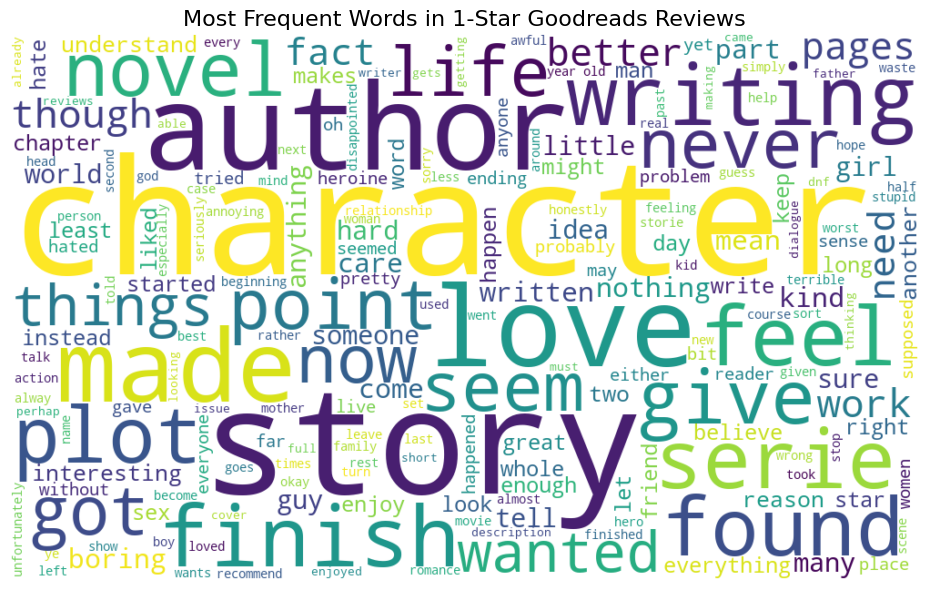

In [25]:
from wordcloud import WordCloud, STOPWORDS

# Combine all review text into one big string
all_reviews = " ".join(review for review in df_1star['review_clean'].dropna())

# Define stopwords to exclude common words
custom_stopwords = set(STOPWORDS)
custom_stopwords.update([ 'book', 'read', 'one', 'really', 'even', 'get', 'know', 'make', 'thing',
    'think', 'way', 'page', 
     'time','would', 'could', 'like', 'well', 'just', 'books',
    'say', 'thought', 'felt', 'want', 'back', 'reading', 'see', 'go', 'going',
    'take', 'something', 'much', 'still', 'good', 'bad', 'end', 'start',
    'main', 'people', 'done', 'felt', 'lot', 'actually', 'put', 'will', 'first', 'use',
    'maybe', 'find', 'say', 'said', 'try', 'trying', 'readers', 'review','books', 'reading', 'one', 'like'
])  

# Generate the word cloud
wordcloud = WordCloud(width=1000, height=600, background_color='white',
                      stopwords=custom_stopwords, max_words=200).generate(all_reviews)

# Plot it
plt.figure(figsize=(12, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title("Most Frequent Words in 1-Star Goodreads Reviews", fontsize=16)
plt.tight_layout()
plt.show()

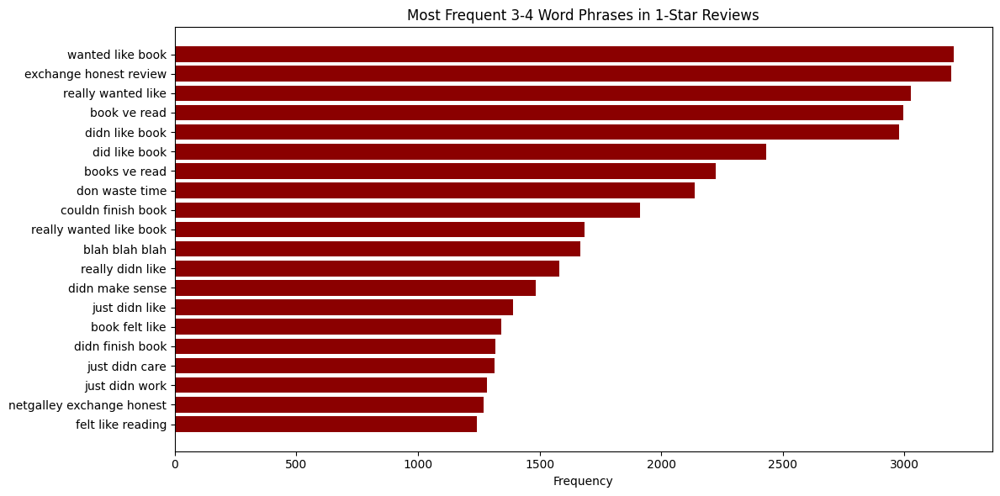

In [26]:
from sklearn.feature_extraction.text import CountVectorizer

# Use bigrams and trigrams
vectorizer = CountVectorizer(ngram_range=(3, 4), stop_words='english', max_features=100)
X = vectorizer.fit_transform(df_1star['review_clean'].dropna())

# Sum the frequencies
sum_words = X.sum(axis=0)
phrases_freq = [(phrase, sum_words[0, idx]) for phrase, idx in vectorizer.vocabulary_.items()]
phrases_freq = sorted(phrases_freq, key=lambda x: x[1], reverse=True)

# Convert to DataFrame
ngram_df = pd.DataFrame(phrases_freq, columns=['Phrase', 'Frequency'])

# Display top results
plt.figure(figsize=(12,6))
plt.barh(ngram_df['Phrase'][:20][::-1], ngram_df['Frequency'][:20][::-1], color='darkred')
plt.title('Most Frequent 3-4 Word Phrases in 1-Star Reviews')
plt.xlabel('Frequency')
plt.tight_layout()
plt.show()

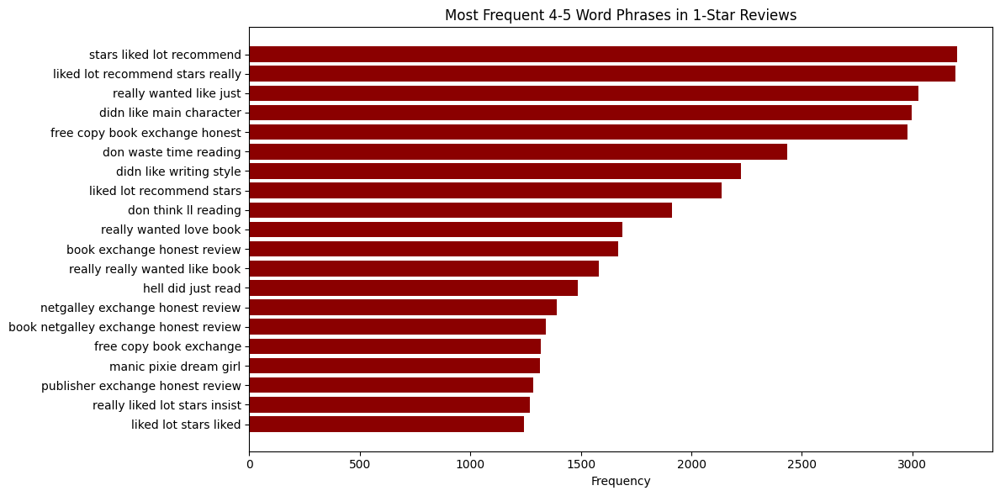

In [28]:
# Use trigrams and longer
vectorizer2 = CountVectorizer(ngram_range=(4, 5), stop_words='english', max_features=100)
X_2 = vectorizer2.fit_transform(df_1star['review_clean'].dropna())

# Sum the frequencies
sum_words2 = X_2.sum(axis=0)
phrases_freq2 = [(phrase, sum_words[0, idx]) for phrase, idx in vectorizer2.vocabulary_.items()]
phrases_freq2 = sorted(phrases_freq2, key=lambda x: x[1], reverse=True)

# Convert to DataFrame
ngram2_df = pd.DataFrame(phrases_freq2, columns=['Phrase', 'Frequency'])

# Display top results
plt.figure(figsize=(12,6))
plt.barh(ngram2_df['Phrase'][:20][::-1], ngram2_df['Frequency'][:20][::-1], color='darkred')
plt.title('Most Frequent 4-5 Word Phrases in 1-Star Reviews')
plt.xlabel('Frequency')
plt.tight_layout()
plt.show()

In [30]:
# Theme mapping dictionary: theme → list of indicative phrases/keywords
complaint_themes = {
    'Character Issues': [
        'main character', 'character development', 'year old', 'immature', 'annoying', 'love interest',
        'unlikable', 'flat character', 'cardboard cutout', 'inconsistent character',
        'poorly developed', 'shallow', 'unlikeable', 'irritating', 'stupid character',
        'weak character', 'flawed character', 'sympathy for', 'no connection with',
        'motivations unclear', 'acted out of character', 'forced relationship',
        'insta-love', 'toxic relationship', 'protagonist', 'antagonist',
        'side character', 'underdeveloped characters', 'one-dimensional',
        'contrived motivations', 'unbelievable actions', 'lack of depth',
        'superficial', 'self-absorbed', 'whiny', 'passive', 'aggressive',
        'jerk', 'bitch', 'mary sue', 'gary stu', 'author insert',
        'wish fulfillment character', 'unearned development',
        'rushed character arc', 'stagnant character', 'rely on stereotypes'
    ],
    'Plot/Structure': [
        'storyline', 'plot', 'spoiler alert', 'twist', 'didn make sense', 'nothing happened',
        'predictable', 'rushed ending', 'slow burn', 'pacing issues', 'convoluted plot',
        'plot holes', 'deus ex machina', 'uneven pacing', 'anticlimactic', 'pointless subplot',
        'disjointed', 'rambling', 'contrived', 'repetitive plot points', 'no resolution',
        'weak plot', 'thin plot', 'overly complicated', 'underdeveloped plot',
        'too much exposition', 'info dump', 'lack of focus', 'meandering',
        'circular narrative', 'incoherent', 'illogical', 'unrealistic plot',
        'convenient coincidences', 'forced conflict', 'lack of stakes',
        'unnecessary scenes', 'padding', 'false climax', 'unsatisfying ending',
        'cliffhanger with no payoff', 'sequel baiting', 'felt incomplete'
    ],
    'Writing Style': [
        'writing style', 'bad writing', 'purple prose', 'repetitive', 'boring', 'poorly written',
        'clunky prose', 'awkward phrasing', 'stilted dialogue', 'unnatural dialogue',
        'telling not showing', 'over descriptive', 'underdeveloped', 'simplistic writing',
        'pretentious writing', 'amateurish', 'grammatical errors', 'typos', 'editing issues',
        'poor sentence structure', 'weak vocabulary', 'monotonous', 'flow issues',
        'choppy', 'dense writing', 'impenetrable', 'overuse of adjectives',
        'clichés', 'hackneyed', 'trite', 'melodramatic', 'overwrought',
        'infodumping through dialogue', 'dialogue felt forced',
        'internal monologue overuse', 'head hopping', 'inconsistent tense'
    ],
    'Engagement': [
        'couldn finish', 'waste time', 'feel like', 'just didn', 'didn like', 'slow', 'dragged',
        'lost interest', 'tedious', 'struggled to get through', 'hard to follow',
        'unengaging', 'dull', 'plodding', 'sleep-inducing', 'wish i hadn read',
        'skimming', 'couldn\'t connect', 'no emotional impact', 'didn care about',
        'wanted it to end', 'a chore to read', 'painful to read', 'eyes glazed over',
        'mind wandered', 'checked page count constantly', 'felt like a slog',
        'momentum stalled', 'pacing was off', 'never invested', 'no suspense',
        'lacked excitement', 'failed to captivate'
    ],
    'Expectations vs Reality': [
        'like book', 'expected', 'thought would', 'overhyped',
        'not what i expected', 'misleading description', 'different from summary',
        'disappointed', 'underwhelming', 'fell flat', 'not as good as', 'wasted potential',
        'false advertising', 'bait and switch', 'promised more than delivered',
        'didn live up to the hype', 'genre wasn\'t what i thought',
        'cover was misleading', 'title was misleading', 'blurb was inaccurate',
        'reviews were misleading', 'fanbase is delusional'
    ],
    'Offensive Content': [
        'offensive', 'problematic', 'sexist', 'racist', 'abuse', 'trigger',
        'misogynistic', 'homophobic', 'ableist', 'culturally insensitive',
        'gory', 'disturbing', 'gratuitous violence', 'sexual assault',
        'animal cruelty', 'hate speech', 'stereotypes', 'colorism', 'fatphobia',
        'victim blaming', 'glorification of violence', 'romanticizing abuse',
        'toxic masculinity', 'white savior trope', 'bury your gays trope',
        'fridging', 'rape as plot device', 'unnecessary graphic detail'
    ],
    'Genre Mismatch': [
        'not romance', 'not fantasy', 'genre', 'more thriller than',
        'felt like', 'marketed as', 'supposed to be', 'wrong genre',
        'elements of', 'blended genres poorly', 'not enough',
        'too much [genre element]', 'this isn\'t [genre]', 'where\'s the',
        'misleading genre tag', 'didn fit the category', 'cross-genre failure',
        'felt like a different genre entirely', 'no present'
    ]
}

In [31]:
def assign_themes(review_text, theme_map):
    review_text = review_text.lower()
    matched_themes = []

    for theme, keywords in theme_map.items():
        if any(kw in review_text for kw in keywords):
            matched_themes.append(theme)

    return matched_themes if matched_themes else ['Uncategorized']

In [32]:
# Apply the theme assignment to your cleaned reviews
df_1star['complaint_themes'] = df_1star['review_clean'].apply(
    lambda x: assign_themes(x, complaint_themes)
)

In [35]:
# Apply the theme assignment to your cleaned reviews
df_1star['complaint_themes'] = df_1star['review_clean'].apply(
    lambda x: assign_themes(x, complaint_themes)
)

In [36]:
from collections import Counter
from itertools import chain

# Flatten list of themes and count
theme_counts = Counter(chain.from_iterable(df_1star['complaint_themes']))
print(theme_counts.most_common())

[('Uncategorized', 161049), ('Plot/Structure', 79342), ('Character Issues', 74817), ('Writing Style', 59249), ('Engagement', 51014), ('Genre Mismatch', 32356), ('Expectations vs Reality', 27743), ('Offensive Content', 19283)]


In [38]:
!pip install nltk

Defaulting to user installation because normal site-packages is not writeable



[notice] A new release of pip is available: 24.2 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [41]:
import nltk
nltk.download('punkt')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\mjack245\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping tokenizers\punkt.zip.


True

In [53]:
import pandas as pd
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from wordcloud import STOPWORDS
import nltk
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import NMF
from nltk.stem import WordNetLemmatizer

# Assuming your DataFrame is named 'sample_1star'
uncategorized_df = df_1star[df_1star['complaint_themes'].apply(lambda x: 'Uncategorized' in x)].copy()
uncategorized_reviews = uncategorized_df['review_clean'].dropna().tolist()

# 1. Define Stopwords (using your combined list)
nltk_stopwords = set(stopwords.words('english'))
wordcloud_stopwords = set(STOPWORDS)
custom_stopwords = set([
    'book', 'read', 'one', 'really', 'even', 'get', 'know', 'make', 'thing',
    'think', 'way', 'page', 'time', 'would', 'could', 'like', 'well', 'just', 'books',
    'say', 'thought', 'felt', 'want', 'back', 'reading', 'see', 'go', 'going',
    'take', 'something', 'much', 'still', 'good', 'bad', 'end', 'start',
    'main', 'people', 'done', 'felt', 'lot', 'actually', 'put', 'will', 'first', 'use',
    'maybe', 'find', 'say', 'said', 'try', 'trying', 'readers', 'review'
])
combined_stopwords_set = nltk_stopwords.union(wordcloud_stopwords).union(custom_stopwords)

# 2. Lemmatization and Stopword Removal for Uncategorized Reviews
lemmatizer = WordNetLemmatizer()
processed_uncategorized_reviews = []
for review in uncategorized_reviews:
    tokens = word_tokenize(review.lower())
    lemmatized_tokens = [lemmatizer.lemmatize(token) for token in tokens]
    processed_tokens = [token for token in lemmatized_tokens if token not in combined_stopwords_set]
    processed_uncategorized_reviews.append(" ".join(processed_tokens))

# 3. Feature Extraction with TF-IDF for Uncategorized Reviews
tfidf_vectorizer_uncat = TfidfVectorizer(stop_words=list(combined_stopwords_set),
                                        ngram_range=(1, 3),
                                        max_df=0.90,
                                        min_df=2)
tfidf_matrix_uncat = tfidf_vectorizer_uncat.fit_transform(processed_uncategorized_reviews)
feature_names_uncat = tfidf_vectorizer_uncat.get_feature_names_out()

# 4. Train the NMF Model for Uncategorized Reviews
num_topics_uncat = 7  # You can experiment with the number of topics for the uncategorized data
nmf_model_uncat = NMF(n_components=num_topics_uncat, random_state=42, max_iter=300)
nmf_model_uncat.fit(tfidf_matrix_uncat)

# 5. Analyze the Topics for Uncategorized Reviews
print("\nNMF Topics for Uncategorized Reviews:")
for topic_idx, topic in enumerate(nmf_model_uncat.components_):
    top_words_indices = topic.argsort()[:-21:-1]
    top_words = [feature_names_uncat[i] for i in top_words_indices]
    print(f"Uncategorized Topic {topic_idx + 1}: {' '.join(top_words)}")

# 6. Get Topic Assignments for Uncategorized Reviews (Optional)
doc_topic_matrix_uncat = nmf_model_uncat.transform(tfidf_matrix_uncat)
dominant_topics_uncat = [row.argmax() + 1 for row in doc_topic_matrix_uncat]

# 7. Add NMF Topic Assignments to the Uncategorized DataFrame (Optional)
uncategorized_df['nmf_topic_uncat'] = pd.Series(dominant_topics_uncat, index=uncategorized_df.index[:len(dominant_topics_uncat)])

# Merge the NMF topic assignments back into the original DataFrame
df_1star = pd.merge(df_1star, uncategorized_df[['review_id', 'nmf_topic_uncat']], on='review_id', how='left')

print("\nDataFrame with NMF Topic Labels for Uncategorized (First 10):")
print(df_1star[['review_clean', 'complaint_themes', 'nmf_topic_uncat']].head(10))

C:\Users\mjack245\AppData\Roaming\Python\Python312\site-packages\sklearn\feature_extraction\text.py:402: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['let'] not in stop_words.
  warnings.warn(



NMF Topics for Uncategorized Reviews:
Uncategorized Topic 1: finish finish wa ca finish ca tried force finish force bored tried finish got couldnt finish wa finish couldnt awful finish bring finish awful finish got hated finish bring bored finish
Uncategorized Topic 2: wa story character author love series writing got never better interesting ca written made chapter many tried dnf wanted awful
Uncategorized Topic 3: hated hated hated hated finish absolutely hated hated wa absolutely school hated character finish hated character hated every hate school hated ugh hated never every hated ending hated everything ending hated hated hated
Uncategorized Topic 4: waste waste money money wa waste complete waste complete total waste horrible total terrible awful terrible waste awful waste waste paper paper absolute finish waste nothing horrible waste life
Uncategorized Topic 5: star ha star liked liked star liked ha liked ha give star wa two star four star ha four star ha star five star ha four

In [46]:
# Get the default NLTK data path
default_nltk_path = nltk.data.path

# Print the default paths to see where NLTK is currently looking
print("Default NLTK data paths:", default_nltk_path)

Default NLTK data paths: ['C:\\Users\\mjack245/nltk_data', 'c:\\Python312\\nltk_data', 'c:\\Python312\\share\\nltk_data', 'c:\\Python312\\lib\\nltk_data', 'C:\\Users\\mjack245\\AppData\\Roaming\\nltk_data', 'C:\\nltk_data', 'D:\\nltk_data', 'E:\\nltk_data']


In [47]:
import nltk
import os

possible_nltk_data_dirs = [
    'C:\\Users\\mjack245\\nltk_data\\tokenizers\\punkt\\PY3',
    'C:\\ProgramData\\Anaconda3\\nltk_data\\tokenizers\\punkt\\PY3',
    'C:\\ProgramData\\Anaconda3\\share\\nltk_data\\tokenizers\\punkt\\PY3',
    'C:\\ProgramData\\Anaconda3\\lib\\nltk_data\\tokenizers\\punkt\\PY3',
    'C:\\Users\\mjack245\\AppData\\Roaming\\nltk_data\\tokenizers\\punkt\\PY3',
    'C:\\nltk_data\\tokenizers\\punkt\\PY3',
    'D:\\nltk_data\\tokenizers\\punkt\\PY3',
    'E:\\nltk_data\\tokenizers\\punkt\\PY3',
    'C:\\Users\\mjack245\\AppData\\Local\\Programs\\Python\\Python312\\nltk_data\\tokenizers\\punkt\\PY3',
    'C:\\Users\\mjack245\\AppData\\Local\\Programs\\Python\\Python312\\share\\nltk_data\\tokenizers\\punkt\\PY3',
    'C:\\Users\\mjack245\\AppData\\Local\\Programs\\Python\\Python312\\lib\\nltk_data\\tokenizers\\punkt\\PY3'
]

found = False
for directory in possible_nltk_data_dirs:
    file_path = os.path.join(directory, 'english.pickle')
    if os.path.exists(file_path):
        print(f"Found 'english.pickle' in: {directory}")
        if directory.rsplit('\\', 3)[0] not in nltk.data.path:
            nltk.data.path.append(directory.rsplit('\\', 3)[0])
            print(f"Added '{directory.rsplit('\\', 3)[0]}' to nltk.data.path")
        found = True
        break

if not found:
    print("'english.pickle' not found in expected locations. Trying download again...")
    nltk.download('punkt')
    # Add the default download locations back
    default_nltk_path = ['C:\\Users\\mjack245/nltk_data', 'c:\\Python312\\nltk_data', 'c:\\Python312\\share\\nltk_data', 'c:\\Python312\\lib\\nltk_data', 'C:\\Users\\mjack245\\AppData\\Roaming\\nltk_data', 'C:\\nltk_data', 'D:\\nltk_data', 'E:\\nltk_data']
    for path in default_nltk_path:
        if path not in nltk.data.path:
            nltk.data.path.append(path)

# Try tokenizing one more time
try:
    from nltk.tokenize import word_tokenize
    sample_text = "This is a test sentence."
    tokens = word_tokenize(sample_text.lower())
    print("Tokenization successful:", tokens)
except LookupError as e:
    print(f"Still getting a LookupError: {e}")
    print("It seems there might be a deeper issue with the NLTK data configuration.")

Found 'english.pickle' in: C:\Users\mjack245\AppData\Roaming\nltk_data\tokenizers\punkt\PY3
Still getting a LookupError: 
**********************************************************************
  Resource punkt_tab not found.
  Please use the NLTK Downloader to obtain the resource:

  >>> import nltk
  >>> nltk.download('punkt_tab')
  
  For more information see: https://www.nltk.org/data.html

  Attempted to load tokenizers/punkt_tab/english/

  Searched in:
    - 'C:\\Users\\mjack245/nltk_data'
    - 'c:\\Python312\\nltk_data'
    - 'c:\\Python312\\share\\nltk_data'
    - 'c:\\Python312\\lib\\nltk_data'
    - 'C:\\Users\\mjack245\\AppData\\Roaming\\nltk_data'
    - 'C:\\nltk_data'
    - 'D:\\nltk_data'
    - 'E:\\nltk_data'
**********************************************************************

It seems there might be a deeper issue with the NLTK data configuration.


In [48]:
import nltk

try:
    nltk.data.find('tokenizers/punkt_tab')
    print("punkt_tab resource is already downloaded.")
except nltk.downloader.DownloadError:
    print("punkt_tab resource not found. Downloading...")
    nltk.download('punkt_tab')
    print("punkt_tab resource downloaded successfully.")
except LookupError:
    print("punkt_tab resource not found. Downloading...")
    nltk.download('punkt_tab')
    print("punkt_tab resource downloaded successfully.")

# Now, let's try to tokenize again
try:
    from nltk.tokenize import word_tokenize
    sample_text = "This is a test sentence."
    tokens = word_tokenize(sample_text.lower())
    print("Tokenization successful:", tokens)
except LookupError as e:
    print(f"Still getting a LookupError: {e}")
    print("It seems there might be a more fundamental issue with the NLTK installation or data.")

AttributeError: module 'nltk.downloader' has no attribute 'DownloadError'

In [49]:
import nltk

try:
    nltk.data.find('tokenizers/punkt_tab')
    print("punkt_tab resource is already downloaded.")
except LookupError:
    print("punkt_tab resource not found. Downloading...")
    try:
        nltk.download('punkt_tab')
        print("punkt_tab resource downloaded successfully.")
    except Exception as e:
        print(f"Error during download: {e}")
        print("There might be a problem with your internet connection or the NLTK download server.")

# Now, let's try to tokenize again
try:
    from nltk.tokenize import word_tokenize
    sample_text = "This is a test sentence."
    tokens = word_tokenize(sample_text.lower())
    print("Tokenization successful:", tokens)
except LookupError as e:
    print(f"Still getting a LookupError after attempting to download punkt_tab: {e}")
    print("It strongly suggests a deeper issue with the NLTK data configuration or installation.")

punkt_tab resource not found. Downloading...


[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\mjack245\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping tokenizers\punkt_tab.zip.


punkt_tab resource downloaded successfully.
Tokenization successful: ['this', 'is', 'a', 'test', 'sentence', '.']


In [51]:
import nltk

try:
    from nltk.corpus import wordnet
    # Try using a WordNet function to see if it works
    synsets = wordnet.synsets("dog")
    print(f"Successfully loaded WordNet. Found synsets for 'dog': {synsets}")
except LookupError:
    print("WordNet resource not found. Downloading...")
    nltk.download('wordnet')
    print("WordNet resource downloaded successfully.")
    try:
        from nltk.corpus import wordnet
        synsets = wordnet.synsets("dog")
        print(f"Successfully loaded WordNet after download. Found synsets for 'dog': {synsets}")
    except LookupError as e:
        print(f"Still getting a LookupError for WordNet after download: {e}")
        print("There might be a persistent issue with NLTK data loading.")

WordNet resource not found. Downloading...


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\mjack245\AppData\Roaming\nltk_data...


WordNet resource downloaded successfully.
Successfully loaded WordNet after download. Found synsets for 'dog': [Synset('dog.n.01'), Synset('frump.n.01'), Synset('dog.n.03'), Synset('cad.n.01'), Synset('frank.n.02'), Synset('pawl.n.01'), Synset('andiron.n.01'), Synset('chase.v.01')]


In [54]:
complaint_themes_updated = {
    'Character Issues': [
        'main character', 'character development', 'year old', 'immature', 'annoying', 'love interest',
        'unlikable', 'flat character', 'cardboard cutout', 'inconsistent character',
        'poorly developed', 'shallow', 'unlikeable', 'irritating', 'stupid character',
        'weak character', 'flawed character', 'sympathy for', 'no connection with',
        'motivations unclear', 'acted out of character', 'forced relationship',
        'insta-love', 'toxic relationship', 'protagonist', 'antagonist',
        'side character', 'underdeveloped characters', 'one-dimensional',
        'contrived motivations', 'unbelievable actions', 'lack of depth',
        'superficial', 'self-absorbed', 'whiny', 'passive', 'aggressive',
        'jerk', 'bitch', 'mary sue', 'gary stu', 'author insert',
        'wish fulfillment character', 'unearned development',
        'rushed character arc', 'stagnant character', 'rely on stereotypes',
        'stupid', 'hate'  # Added from Strong Negative Sentiment
    ],
    'Plot/Structure': [
        'storyline', 'plot', 'spoiler alert', 'twist', 'didn make sense', 'nothing happened',
        'predictable', 'rushed ending', 'slow burn', 'pacing issues', 'convoluted plot',
        'plot holes', 'deus ex machina', 'uneven pacing', 'anticlimactic', 'pointless subplot',
        'disjointed', 'rambling', 'contrived', 'repetitive plot points', 'no resolution',
        'weak plot', 'thin plot', 'overly complicated', 'underdeveloped plot',
        'too much exposition', 'info dump', 'lack of focus', 'meandering',
        'circular narrative', 'incoherent', 'illogical', 'unrealistic plot',
        'convenient coincidences', 'forced conflict', 'lack of stakes',
        'unnecessary scenes', 'padding', 'false climax', 'unsatisfying ending',
        'cliffhanger with no payoff', 'sequel baiting', 'felt incomplete',
        'story' # Added from Uncategorized Topic 1 and 4
    ],
    'Writing Style': [
        'writing style', 'bad writing', 'purple prose', 'repetitive', 'boring', 'poorly written',
        'clunky prose', 'awkward phrasing', 'stilted dialogue', 'unnatural dialogue',
        'telling not showing', 'over descriptive', 'underdeveloped', 'simplistic writing',
        'pretentious writing', 'amateurish', 'grammatical errors', 'typos', 'editing issues',
        'poor sentence structure', 'weak vocabulary', 'monotonous', 'flow issues',
        'choppy', 'dense writing', 'impenetrable', 'overuse of adjectives',
        'clichés', 'hackneyed', 'trite', 'melodramatic', 'overwrought',
        'infodumping through dialogue', 'dialogue felt forced',
        'internal monologue overuse', 'head hopping', 'inconsistent tense',
        'written' # Added from Uncategorized Topic 4
    ],
    'Engagement': [
        'couldn finish', 'waste time', 'feel like', 'just didn', 'didn like', 'slow', 'dragged',
        'lost interest', 'tedious', 'struggled to get through', 'hard to follow',
        'unengaging', 'dull', 'plodding', 'sleep-inducing', 'wish i hadn read',
        'skimming', 'couldn\'t connect', 'no emotional impact', 'didn care about',
        'wanted it to end', 'a chore to read', 'painful to read', 'eyes glazed over',
        'mind wandered', 'checked page count constantly', 'felt like a slog',
        'momentum stalled', 'pacing was off', 'never invested', 'no suspense',
        'lacked excitement', 'failed to captivate',
        'couldn\'t continue', 'gave up', 'stopped reading', 'dnf', 'did not finish',
        'bored', 'finish', 'disappointment', 'wa' # Added from NMF Topics
    ],
    'Expectations vs Reality': [
        'like book', 'expected', 'thought would', 'overhyped',
        'not what i expected', 'misleading description', 'different from summary',
        'disappointed', 'underwhelming', 'fell flat', 'not as good as', 'wasted potential',
        'false advertising', 'bait and switch', 'promised more than delivered',
        'didn live up to the hype', 'genre wasn\'t what i thought',
        'cover was misleading', 'title was misleading', 'blurb was inaccurate',
        'reviews were misleading', 'fanbase is delusional',
        'waste of time', 'waste of money', 'didn\'t feel worth it', 'awful', 'terrible' # Added from NMF Topics
    ],
    'Offensive Content': [
        'offensive', 'problematic', 'sexist', 'racist', 'abuse', 'trigger',
        'misogynistic', 'homophobic', 'ableist', 'culturally insensitive',
        'gory', 'disturbing', 'gratuitous violence', 'sexual assault',
        'animal cruelty', 'hate speech', 'stereotypes', 'colorism', 'fatphobia',
        'victim blaming', 'glorification of violence', 'romanticizing abuse',
        'toxic masculinity', 'white savior trope', 'bury your gays trope',
        'fridging', 'rape as plot device', 'unnecessary graphic detail'
    ],
    'Genre Mismatch': [
        'not romance', 'not fantasy', 'genre', 'more thriller than',
        'felt like', 'marketed as', 'supposed to be', 'wrong genre',
        'elements of', 'blended genres poorly', 'not enough',
        'too much [genre element]', 'this isn\'t [genre]', 'where\'s the',
        'misleading genre tag', 'didn fit the category', 'cross-genre failure',
        'felt like a different genre entirely', 'no present'
    ]
}

In [55]:
def assign_themes_updated(review_text, theme_map):
    review_text = review_text.lower()
    matched_themes = []

    for theme, keywords in theme_map.items():
        if any(kw in review_text for kw in keywords):
            matched_themes.append(theme)

    return matched_themes if matched_themes else ['Uncategorized']

In [56]:
# Apply the updated theme assignment and store in the correct column
df_1star['complaint_themes_updated'] = df_1star['review_clean'].apply(
    lambda x: assign_themes_updated(x, complaint_themes_updated)
)

from collections import Counter
from itertools import chain

# Flatten list of themes and count the updated themes
theme_counts_updated = Counter(chain.from_iterable(df_1star['complaint_themes_updated']))
print(theme_counts_updated.most_common())

print("\nDataFrame with Updated Complaint Themes (First 10):")
print(df_1star[['review_clean', 'complaint_themes', 'complaint_themes_updated']].head(10))

[('Engagement', 275420), ('Plot/Structure', 141187), ('Character Issues', 104867), ('Writing Style', 83132), ('Expectations vs Reality', 57345), ('Uncategorized', 47263), ('Genre Mismatch', 32356), ('Offensive Content', 19283)]

DataFrame with Updated Complaint Themes (First 10):
                                        review_clean  \
0  read this while recovering from surgery. i wan...   
1  my heart goes out to georgia for what she expe...   
2  i always feel badly leaving a poor rating beca...   
3  very difficult to get through. don't waste you...   
4  this book was horrible. i really don't know ho...   
5             boring. couldn't even finish it. blah.   
6  after reading i finished i capture the castle,...   
7  this book was well written, but ultimately mad...   
8  groan, eye roll, page turn, repeat. just kiddi...   
9  are you kidding me?? how has this guys dick no...   

                 complaint_themes  \
0                 [Uncategorized]   
1  [Character Issues, Engage

In [57]:
theme_palette = { #distinct under colorblind simulations
    'Engagement': '#1b9e77',          # dark teal
    'Plot/Structure': '#d95f02',      # orange
    'Character Issues': '#7570b3',    # purple-blue
    'Writing Style': '#e7298a',       # reddish pink
    'Expectations vs Reality': '#66a61e',  # olive green
    'Genre Mismatch': '#e6ab02',      # yellow-brown
    'Offensive Content': '#a6761d',   # brown 
    'Uncategorized': '#666666'        # dark gray (if every shown)
}

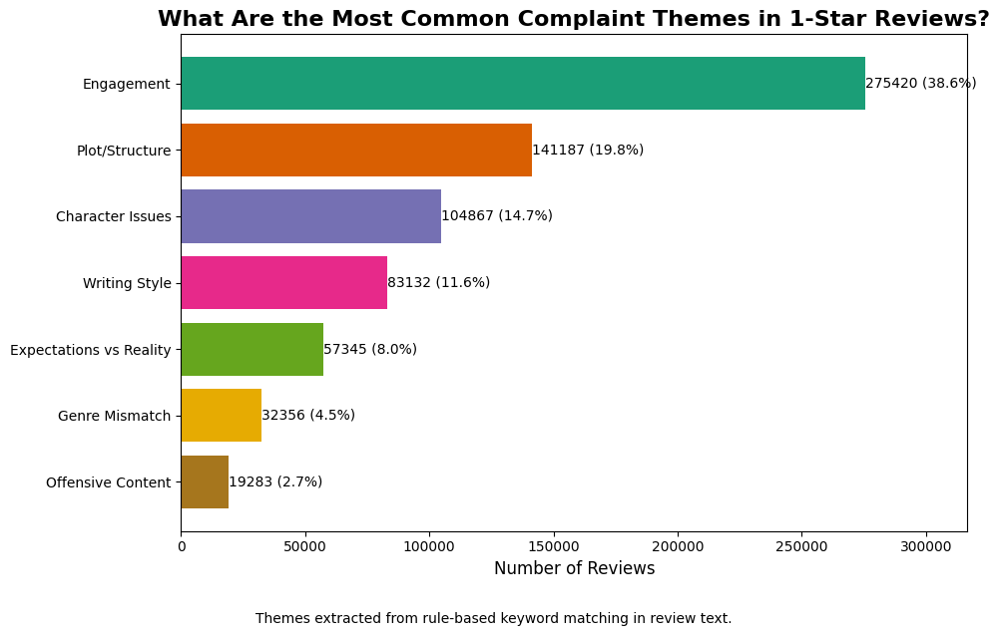

In [58]:
# Filter out 'Uncategorized' and sort by frequency
filtered_theme_counts = {k: v for k, v in theme_counts_updated.items() if k.lower() != 'uncategorized'}
top_themes = sorted(filtered_theme_counts.items(), key=lambda x: x[1], reverse=True)
labels, counts = zip(*top_themes)

# Apply your fixed, colorblind-accessible palette
colors = [theme_palette[label] for label in labels]

# Plot
plt.figure(figsize=(10, 6))
bars = plt.barh(labels, counts, color=colors)

# Title and axis
plt.title("What Are the Most Common Complaint Themes in 1-Star Reviews?", fontsize=16, weight='bold')
plt.xlabel("Number of Reviews", fontsize=12)

# Add value + percentage labels
total = sum(counts)
for bar, count in zip(bars, counts):
    percent = (count / total) * 100
    plt.text(
        bar.get_width() + 5,
        bar.get_y() + bar.get_height() / 2,
        f"{count} ({percent:.1f}%)",
        va='center', fontsize=10
    )

# Visual refinements
plt.gca().invert_yaxis()  # Highest count on top
plt.grid(False)
plt.figtext(0.5, -0.05,
            "Themes extracted from rule-based keyword matching in review text.",
            wrap=True, horizontalalignment='center', fontsize=10)
plt.xlim(0, max(counts) * 1.15)  # Adds 15% padding to the right
plt.tight_layout()

# Save then show
plt.savefig('themes_1star_reviews.jpg', format='jpg', dpi=300, bbox_inches='tight')
plt.show()

In [59]:
pip install adjustText

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.2 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


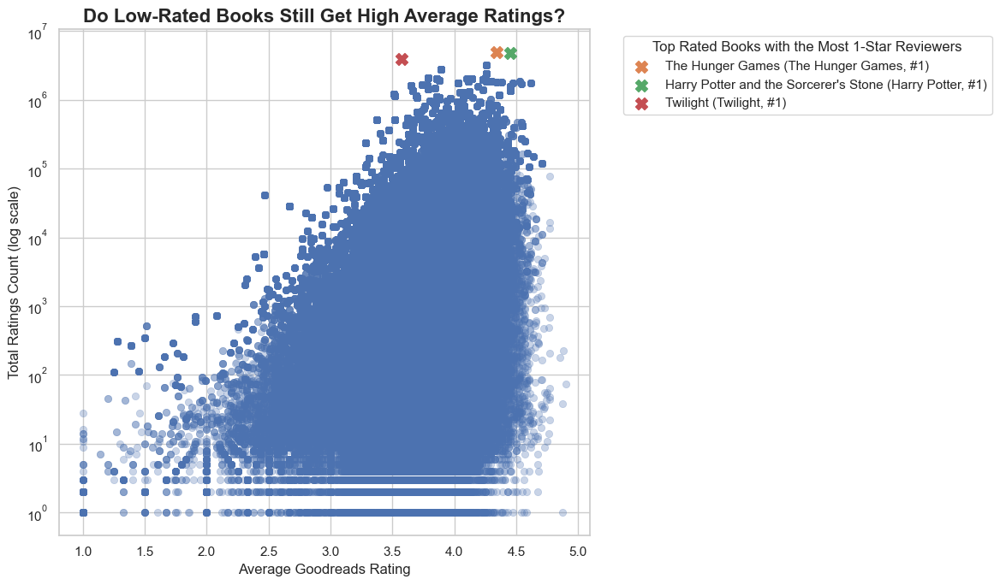

In [60]:
# Set style
sns.set(style="whitegrid")
plt.figure(figsize=(12, 7))

# Base scatterplot
sns.scatterplot(
    data=df_1star,
    x='average_rating',
    y='ratings_count',
    alpha=0.3,
    edgecolor=None
)

plt.yscale('log')

# Top books — no duplicate titles
top_books = (
    df_1star.sort_values(by='ratings_count', ascending=False)
    .drop_duplicates(subset='title')
    .head(3)
)

# Highlight top books with custom markers and legend
for _, row in top_books.iterrows():
    plt.scatter(row['average_rating'], row['ratings_count'], s=100, marker='X', label=row['title'], zorder=5)

# Add title and labels
plt.title("Do Low-Rated Books Still Get High Average Ratings?", fontsize=16, fontweight='bold')
plt.xlabel("Average Goodreads Rating", fontsize=12)
plt.ylabel("Total Ratings Count (log scale)", fontsize=12)

# Legend
plt.legend(title='Top Rated Books with the Most 1-Star Reviewers', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.savefig("low_rated_books_high_rating_legend.jpg", format='jpg', dpi=300, bbox_inches='tight')
plt.show()

In [62]:
# Create a new column with the first complaint theme (or 'Uncategorized')

df_1star['top_theme'] = df_1star['complaint_themes_updated'].apply(lambda x: x[0] if isinstance(x, list) and x else 'Uncategorized'

)

In [63]:
# Remove duplicate titles to avoid overplotting books reviewed multiple times
unique_books = df_1star.drop_duplicates(subset='title')

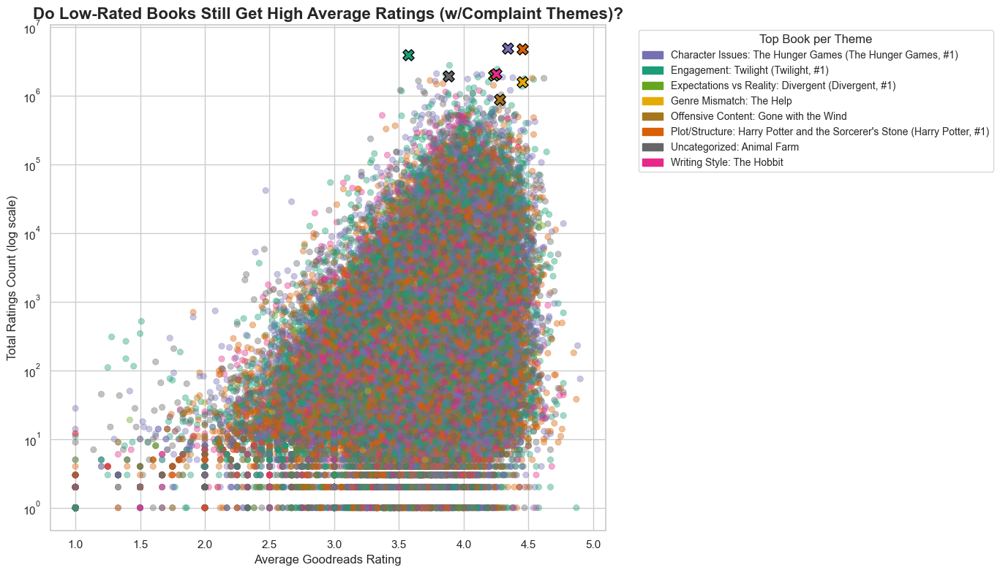

In [64]:
import matplotlib.patches as mpatches

# Drop duplicate book titles to avoid overplotting
unique_books = df_1star.drop_duplicates(subset='title')

# Get top-rated book (by ratings count) per complaint theme
top_books_by_theme = (
    unique_books
    .sort_values(by='ratings_count', ascending=False)
    .groupby('top_theme')
    .first()
    .reset_index()
)

# Plot setup
plt.figure(figsize=(14, 8))
sns.set(style="whitegrid")

# Base scatterplot
sns.scatterplot(
    data=unique_books,
    x='average_rating',
    y='ratings_count',
    hue='top_theme',
    palette=theme_palette,
    alpha=0.4,
    edgecolor=None
)

# Highlight top books per theme with larger X markers
legend_handles = []
for _, row in top_books_by_theme.iterrows():
    plt.scatter(
        row['average_rating'],
        row['ratings_count'],
        s=120,
        marker='X',
        color=theme_palette.get(row['top_theme'], '#000000'),
        edgecolor='black',
        linewidth=1.0,
        zorder=5
    )
    legend_handles.append(mpatches.Patch(
        color=theme_palette.get(row['top_theme'], '#000000'),
        label=f"{row['top_theme']}: {row['title']}"
    ))

# Axis settings
plt.yscale('log')
plt.xlabel("Average Goodreads Rating", fontsize=12)
plt.ylabel("Total Ratings Count (log scale)", fontsize=12)
plt.title("Do Low-Rated Books Still Get High Average Ratings (w/Complaint Themes)?", fontsize=16, fontweight='bold')

# Combined legend: themes and top books
plt.legend(handles=legend_handles, title="Top Book per Theme", bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)

plt.tight_layout()
plt.savefig('low_rated_books_by_theme_highlights.jpg', format='jpg', dpi=300, bbox_inches='tight')
plt.show()

C:\Users\mjack245\AppData\Local\Temp\ipykernel_129996\180873350.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


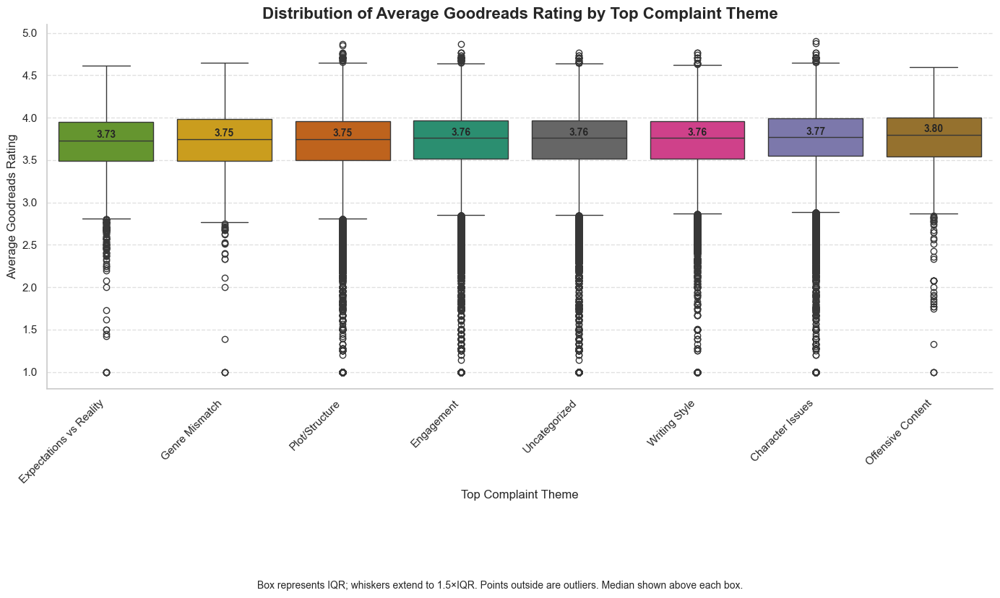

In [65]:
# Sort by median to show themes in order
theme_order = (
    df_1star.groupby('top_theme')['average_rating']
    .median()
    .sort_values()
    .index
)

plt.figure(figsize=(14, 8))
sns.boxplot(
    x='top_theme',
    y='average_rating',
    data=df_1star,
    order=theme_order,
    palette=theme_palette
)

# Add median labels above each box
medians = df_1star.groupby('top_theme')['average_rating'].median().reindex(theme_order)
for i, (theme, median) in enumerate(medians.items()):
    plt.text(i, median + 0.03, f"{median:.2f}", ha='center', fontsize=10, weight='bold')

# Labels and styling
plt.title("Distribution of Average Goodreads Rating by Top Complaint Theme", fontsize=16, fontweight='bold')
plt.xlabel("Top Complaint Theme", fontsize=12)
plt.ylabel("Average Goodreads Rating", fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=11)
plt.yticks(fontsize=11)
plt.grid(axis='y', linestyle='--', alpha=0.6)
sns.despine()

# Footnote for interpretation
plt.figtext(0.5, -0.08,
            "Box represents IQR; whiskers extend to 1.5×IQR. Points outside are outliers. Median shown above each box.",
            wrap=True, horizontalalignment='center', fontsize=10)

plt.tight_layout(rect=[0, 0.05, 1, 0.95])
plt.savefig('avg_goodreads_rating_by_theme_boxplot.jpg', format='jpg', dpi=300, bbox_inches='tight')
plt.show()

C:\Users\mjack245\AppData\Local\Temp\ipykernel_129996\3491206365.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='top_theme', y='ratings_count', data=df_1star, palette=theme_palette)


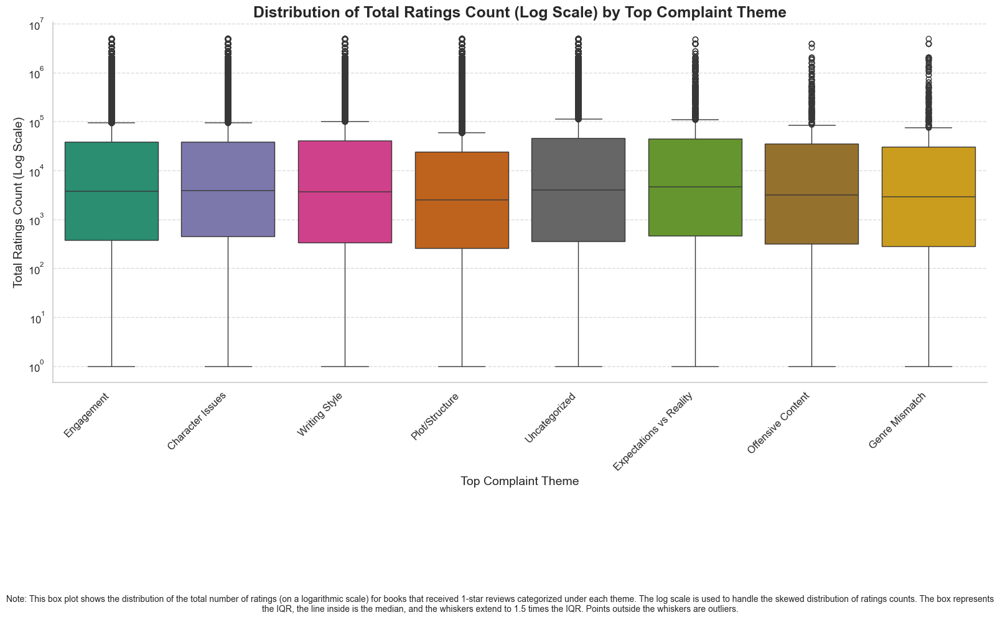

In [66]:
plt.figure(figsize=(16, 9))
sns.boxplot(x='top_theme', y='ratings_count', data=df_1star, palette=theme_palette)
plt.yscale('log')

plt.title("Distribution of Total Ratings Count (Log Scale) by Top Complaint Theme", fontsize=18, fontweight='bold')
plt.xlabel("Top Complaint Theme", fontsize=14)
plt.ylabel("Total Ratings Count (Log Scale)", fontsize=14)

plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)

plt.grid(axis='y', linestyle='--', alpha=0.7)
sns.despine()

plt.figtext(0.5, -0.15,
            "Note: This box plot shows the distribution of the total number of ratings (on a logarithmic scale) for books that received 1-star reviews categorized under each theme. The log scale is used to handle the skewed distribution of ratings counts. The box represents the IQR, the line inside is the median, and the whiskers extend to 1.5 times the IQR. Points outside the whiskers are outliers.",
            wrap=True, horizontalalignment='center', fontsize=10)

plt.tight_layout(rect=[0, 0.05, 1, 0.95])
plt.savefig('distribution_total_ratings_logscale_by_complaint_theme.jpg', format='jpg', dpi=300, bbox_inches='tight')
plt.show()

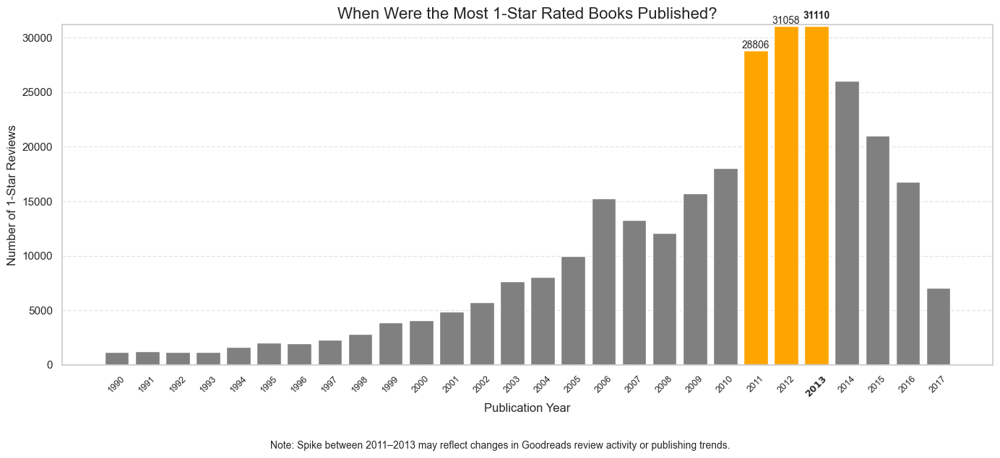

In [67]:
# Get filtered year counts
df_1star_clean = df_1star[(df_1star['publication_year'] >= 1990) & 
                                  (df_1star['publication_year'] <= 2018)]

# Generate a complete index from 1990–2020 (so every year is shown)
year_range = list(range(1990, 2018))

# Count and reindex to include all years
year_counts = df_1star_clean['publication_year'].value_counts().sort_index()
year_counts = year_counts.reindex(year_range, fill_value=0)

# --- STEP 2: Plot the Data ---
highlight_years = [2011, 2012, 2013]
colors = ['orange' if year in highlight_years else 'gray' for year in year_counts.index]

fig, ax = plt.subplots(figsize=(14, 6))

bars = ax.bar(year_counts.index, year_counts.values, color=colors)

# Add exact labels for 2011–2013 just above bars (except 2013, which we'll bold separately)
for bar in bars:
    year = int(bar.get_x() + bar.get_width() / 2)
    height = bar.get_height()
    if year in highlight_years and year != 2013:
        ax.text(bar.get_x() + bar.get_width() / 2, height + 5,
                f'{int(height)}', ha='center', va='bottom', fontsize=10)
# Axis settings
ax.set_title("When Were the Most 1-Star Rated Books Published?", fontsize=16)
ax.set_xlabel("Publication Year")
ax.set_ylabel("Number of 1-Star Reviews")
ax.set_xticks(year_range)
# Bold the label for 2013
xtick_labels = []
for year in year_range:
    if year == 2013:
        xtick_labels.append(f'$\\bf{{{year}}}$')  # LaTeX bold
    else:
        xtick_labels.append(str(year))

ax.set_xticklabels(xtick_labels, rotation=45, fontsize=9)
# Remove vertical gridlines
ax.grid(axis='y', linestyle='--', alpha=0.5)
ax.grid(axis='x', visible=False)

# Highlight 2013 value in bold above the bar
highlight_year = 2013
highlight_value = year_counts[highlight_year]

ax.annotate(f'{highlight_value}',
            xy=(highlight_year, highlight_value),
            xytext=(0, 5),
            textcoords='offset points',
            ha='center',
            va='bottom',
            fontsize=10,
            fontweight='bold')  # Make the label bold

# Add padding above the tallest bar
ax.set_ylim(0, year_counts.max() + 80)

# Add a footnote
plt.figtext(0.5, -0.05,
            "Note: Spike between 2011–2013 may reflect changes in Goodreads review activity or publishing trends.",
            wrap=True, horizontalalignment='center', fontsize=10)

plt.tight_layout()
plt.savefig('when_were_most_1star_reviews_published.jpg', format='jpg', dpi=300, bbox_inches='tight')
plt.show()

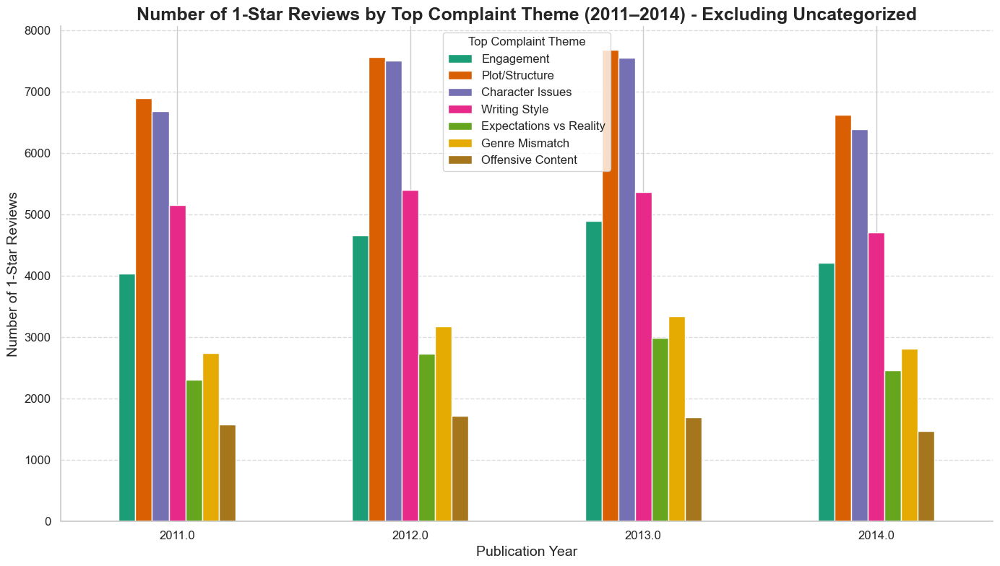

In [78]:
filter_years_df = df_1star[df_1star['publication_year'].isin([2011, 2012, 2013, 2014])].copy()

# Filter out rows where 'Uncategorized' is present in the 'complaint_themes' list
filtered_themes_df = filter_years_df[
    filter_years_df['complaint_themes'].apply(lambda x: 'Uncategorized' not in x if isinstance(x, list) else True)
]

df_exploded = filtered_themes_df.explode('complaint_themes')

# Then, group by year and count the occurrences of each theme
theme_counts = df_exploded.groupby(['publication_year', 'complaint_themes']).size().unstack(fill_value=0)

# Now, select only the themes present in color palette
theme_counts_by_year = theme_counts[[col for col in theme_palette.keys() if col in theme_counts.columns]]

# Plot
ax = theme_counts_by_year.plot(
    kind='bar',
    figsize=(14, 8),
    color=[theme_palette[col] for col in theme_counts_by_year.columns]
)

# Formatting
ax.set_title("Number of 1-Star Reviews by Top Complaint Theme (2011–2014) - Excluding Uncategorized", fontsize=18, fontweight='bold')
ax.set_xlabel("Publication Year", fontsize=14)
ax.set_ylabel("Number of 1-Star Reviews", fontsize=14)
ax.tick_params(axis='x', labelrotation=0, labelsize=12)
ax.tick_params(axis='y', labelsize=12)
ax.legend(title='Top Complaint Theme', fontsize=12)
ax.grid(axis='y', linestyle='--', alpha=0.7)
sns.despine()

plt.tight_layout()
plt.savefig('1star_reviews_by_theme_2011_2014_no_uncategorized.jpg', format='jpg', dpi=300, bbox_inches='tight')
plt.show()

C:\Users\mjack245\AppData\Local\Temp\ipykernel_129996\913755722.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  theme_by_year = df_1star.groupby('year_bin')['top_theme'].value_counts(normalize=True).unstack(fill_value=0)


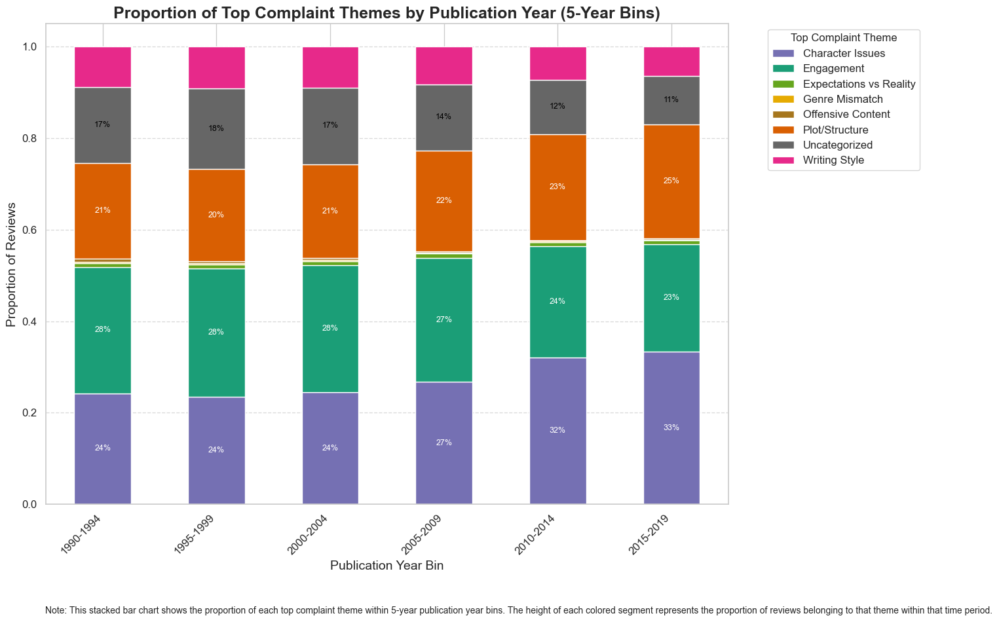

In [69]:
# Create year bins
bins = list(range(1990, 2021, 5))
labels = [f'{i}-{i+4}' for i in bins[:-1]]
df_1star['year_bin'] = pd.cut(df_1star['publication_year'], bins=bins, labels=labels, right=False)

# Group by year bin and top_theme
theme_by_year = df_1star.groupby('year_bin')['top_theme'].value_counts(normalize=True).unstack(fill_value=0)

# Plot
plt.figure(figsize=(16, 9))
ax = theme_by_year.plot(
    kind='bar',
    stacked=True,
    color=[theme_palette.get(col, '#cccccc') for col in theme_by_year.columns],  # apply theme_palette
    ax=plt.gca()
)

plt.title("Proportion of Top Complaint Themes by Publication Year (5-Year Bins)", fontsize=18, fontweight='bold')
plt.xlabel("Publication Year Bin", fontsize=14)
plt.ylabel("Proportion of Reviews", fontsize=14)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)

plt.legend(title='Top Complaint Theme', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout(rect=[0, 0, 0.9, 1])

# Add percentage labels
for i, bin_label in enumerate(theme_by_year.index):
    y_offset = 0
    for theme in theme_by_year.columns:
        height = theme_by_year.loc[bin_label, theme]
        if height > 0.1:
            plt.text(
                i,
                y_offset + height / 2,
                f'{(height * 100):.0f}%',
                ha='center',
                va='center',
                fontsize=9,
                color='white' if height > 0.2 else 'black'
            )
        y_offset += height

# Add caption
plt.figtext(
    0.5, -0.05,
    "Note: This stacked bar chart shows the proportion of each top complaint theme within 5-year publication year bins. "
    "The height of each colored segment represents the proportion of reviews belonging to that theme within that time period.",
    wrap=True, horizontalalignment='center', fontsize=10
)

# Save and show
plt.savefig('proportion_complaint_themes_by_year_bin.jpg', format='jpg', dpi=300, bbox_inches='tight')
plt.show()

# Optional: Clean up temporary column
df_1star.drop(columns=['year_bin'], inplace=True)

# A look into shelves - the conundrum of genres

In [79]:
#cleaning popular shelves column
print(sample_1star['popular_shelves'].iloc[0])

[{'count': '852', 'name': 'to-read'}, {'count': '58', 'name': 'currently-reading'}, {'count': '46', 'name': 'fiction'}, {'count': '45', 'name': 'ted-bell'}, {'count': '40', 'name': 'thriller'}, {'count': '19', 'name': 'adventure'}, {'count': '18', 'name': 'default'}, {'count': '18', 'name': 'espionage'}, {'count': '15', 'name': 'owned'}, {'count': '13', 'name': 'action'}, {'count': '13', 'name': 'thrillers'}, {'count': '12', 'name': 'mystery'}, {'count': '8', 'name': 'books-i-own'}, {'count': '8', 'name': 'series'}, {'count': '8', 'name': 'spy-thriller'}, {'count': '7', 'name': 'spy'}, {'count': '6', 'name': 'audiobook'}, {'count': '6', 'name': 'bell-ted'}, {'count': '5', 'name': 'my-library'}, {'count': '5', 'name': 'audio'}, {'count': '5', 'name': 'alexander-hawke'}, {'count': '5', 'name': 'mystery-thriller'}, {'count': '5', 'name': 'suspense'}, {'count': '4', 'name': 'owned-books'}, {'count': '4', 'name': 'paperback'}, {'count': '4', 'name': 'own-to-read'}, {'count': '4', 'name': 'h

In [ ]:
#seeing which shelves have the highest counts
#function that extracts shelf names from string lists of the shelf dictionaires
def shelf_names(shelves_str):
    shelves_list = ast.literal_eval(shelves_str) #convert the string to a list of dicts
    if isinstance(shelves_list, list):
        return [shelf['name'] for shelf in shelves_list if 'name' in shelf] #extract 'name' value from each dict if it exists
    return []

shelf_counter = Counter()

In [80]:
shelf_cleaning = {
    'cowboys': 'cowboy',
    'chick lit': 'chick lit',
    'adult fiction': 'adult fiction',
    'cowboy western': 'cowboy western',
    'genre western': 'western',
    'romantic suspense': 'romantic suspense',
    'action': 'action',
    'series romance': 'romance',
    'genre romance': 'romance',
    'romance modern': 'modern romance',
    'science fiction': 'science fiction',
    'sci fi': 'science fiction',
    'scifi': 'science fiction',
    'post apocalyptic': 'post apocalyptic',
    'sf': 'science fiction',
    'sci fi fantasy': 'science fiction fantasy',
    'dystopia': 'dystopian',
    'fantasy sci fi': 'science fiction fantasy',
    'apocalypse': 'apocalyptic',
    'space opera': 'space opera',
    'science fiction fantasy': 'science fiction fantasy',
    'hard sci fi': 'hard science fiction',
    'sff': 'science fiction fantasy',
    'post apocalypse': 'post apocalyptic',
    'sf fantasy': 'science fiction fantasy',
    'sci fi and fantasy': 'science fiction fantasy',
    'hard scifi': 'hard science fiction',
    'sciencefiction': 'science fiction',
    'regency romance': 'regency romance',
    'romance historical': 'historical romance',
    'mf': 'm f',
    'historical romances': 'historical romance',
    'historicals': 'historical',
    'humorous': 'humor',
    'humour': 'humor',
    'humour comedy': 'humor',
    'young adult': 'young adult',
    'ya': 'young adult',
    'fairies': 'fairies',
    'faeries': 'fairies',
    'faerie': 'fairies',
    'fey': 'fae',
    'ya fantasy': 'young adult fantasy',
    'paranormal romance': 'paranormal romance',
    'historical fantasy': 'historical fantasy',
    'historical fic': 'historical fiction',
    'supernatural': 'supernatural',
    'faries': 'fairies',
    'classic lit': 'classic literature',
    'british lit': 'british literature',
    'brit lit': 'british literature',
    'english lit': 'english literature',
    'lit': 'literature',
    'feminist': 'feminism',
    'ya books': 'young adult books',
    'ya fiction': 'young adult fiction',
    'ya': 'young adult',
    'non fiction': 'nonfiction',
    'non fic': 'nonfiction',
    'distopian': 'dystopian',
    'ya dystopian': 'young adult dystopian',
    'ya lit': 'young adult literature'
}

In [81]:
shelf_cleaning.update({
    'women s fiction': 'womens fiction',
    'womens fiction': 'womens fiction', 
    'children s': 'children books',
    'childrens books': 'children books',
    'children s books': 'children books',
    'children': 'children books',
    'childrens': 'children books',
    'kids books': 'children books',
    'kid books': 'children books',
    'general fiction': 'fiction',
    'novels': 'novel',
})

In [82]:
import ast

def inspect_popular_shelves(popular_shelves_str):
    try:
        parsed = ast.literal_eval(popular_shelves_str)
        print("Successfully parsed:")
        print(parsed)
        print("Type:", type(parsed))
        if isinstance(parsed, list):
            for item in parsed:
                print("  Item:", item)
                print("  Type:", type(item))
    except (SyntaxError, ValueError) as e:
        print(f"Parsing error: {e}")
        print("Original string:", repr(popular_shelves_str))
    except Exception as e:
        print(f"Unexpected error: {e}")
        print("Original string:", repr(popular_shelves_str))

# Inspect the first few rows of the 'popular_shelves' column
df_1star['popular_shelves'].head(5).apply(inspect_popular_shelves)

Successfully parsed:
[{'count': '852', 'name': 'to-read'}, {'count': '58', 'name': 'currently-reading'}, {'count': '46', 'name': 'fiction'}, {'count': '45', 'name': 'ted-bell'}, {'count': '40', 'name': 'thriller'}, {'count': '19', 'name': 'adventure'}, {'count': '18', 'name': 'default'}, {'count': '18', 'name': 'espionage'}, {'count': '15', 'name': 'owned'}, {'count': '13', 'name': 'action'}, {'count': '13', 'name': 'thrillers'}, {'count': '12', 'name': 'mystery'}, {'count': '8', 'name': 'books-i-own'}, {'count': '8', 'name': 'series'}, {'count': '8', 'name': 'spy-thriller'}, {'count': '7', 'name': 'spy'}, {'count': '6', 'name': 'audiobook'}, {'count': '6', 'name': 'bell-ted'}, {'count': '5', 'name': 'my-library'}, {'count': '5', 'name': 'audio'}, {'count': '5', 'name': 'alexander-hawke'}, {'count': '5', 'name': 'mystery-thriller'}, {'count': '5', 'name': 'suspense'}, {'count': '4', 'name': 'owned-books'}, {'count': '4', 'name': 'paperback'}, {'count': '4', 'name': 'own-to-read'}, {'co

0    None
1    None
2    None
3    None
4    None
Name: popular_shelves, dtype: object

In [84]:
import ast
from lcgft_config import lcgft_mapping # Assuming this mapping exists
from blacklist_config import blacklist # Assuming this blacklist exists

def clean_name(name):
    cleaned = name.lower().replace('-', ' ').replace('_', ' ').strip()
    for _ in range(2):
        if cleaned.startswith("'") and cleaned.endswith("'"):
            cleaned = cleaned[1:-1].strip()
        elif cleaned.startswith('"') and cleaned.endswith('"'):
            cleaned = cleaned[1:-1].strip()
    return cleaned.strip()

def extract_genres_and_tropes_from_shelves(popular_shelves_str, lcgft_map, blacklist_set):
    extracted_lcgft = set()
    extracted_tropes = set()
    try:
        shelves_list = ast.literal_eval(popular_shelves_str)
        if isinstance(shelves_list, list):
            for shelf in shelves_list:
                if isinstance(shelf, dict) and 'name' in shelf:
                    shelf_name = clean_name(shelf['name'])
                    if shelf_name not in blacklist_set:
                        if shelf_name in lcgft_map:
                            extracted_lcgft.add(lcgft_map[shelf_name])
                        else:
                            # If not in the mapping, consider it a trope (for now)
                            extracted_tropes.add(shelf_name)
    except (SyntaxError, ValueError) as e:
        print(f"Error parsing popular_shelves string: {popular_shelves_str}")
        print(f"Error details: {e}")
    except Exception as e:
        print(f"An unexpected error occurred: {e}")
        print(f"String: {popular_shelves_str}")
    return list(extracted_lcgft), list(extracted_tropes)

# Load your mapping and blacklist
lcgft_mapping_lower = {k.lower(): v for k, v in lcgft_mapping.items()}
blacklist_words = set(word.lower() for word in blacklist)

# Apply the new function
shelf_results_df = df_1star['popular_shelves'].apply(extract_genres_and_tropes_from_shelves, args=(lcgft_mapping_lower, blacklist_words,))

# Assign the columns
df_1star['lcgft_genres'] = shelf_results_df.apply(lambda x: x[0])
df_1star['trope_keywords'] = shelf_results_df.apply(lambda x: x[1])

print(df_1star[['popular_shelves', 'lcgft_genres', 'trope_keywords']].head())

                                     popular_shelves  \
0  [{'count': '852', 'name': 'to-read'}, {'count'...   
1  [{'count': '115', 'name': 'to-read'}, {'count'...   
2  [{'count': '2666', 'name': 'to-read'}, {'count...   
3  [{'count': '1499', 'name': 'to-read'}, {'count...   
4  [{'count': '1524', 'name': 'to-read'}, {'count...   

                                        lcgft_genres  \
0  [Detective and mystery fiction, Thrillers (Fic...   
1                                                 []   
2  [Detective and mystery fiction, Cozy mysteries...   
3  [Creative nonfiction, Humorous fiction, Biogra...   
4  [Detective and mystery fiction, Thrillers (Fic...   

                                      trope_keywords  
0  [ted bell alexander hawke, action thriller, al...  
1  [biography memoirs, non fiction, all books, ki...  
2  [suspense thriller, mystery humour, free kindl...  
3  [non fiction, shelfari favorites, lgbtqia, fin...  
4  [flop abuser, recommendations from sj, horror,..

In [86]:
import pandas as pd
pd.set_option('display.max_rows', None)
print(df_1star['trope_keywords'])
# After viewing, you might want to reset the option to default
pd.set_option('display.max_rows', 20) # Or your preferred default

0         [ted bell alexander hawke, action thriller, al...
1         [biography memoirs, non fiction, all books, ki...
2         [suspense thriller, mystery humour, free kindl...
3         [non fiction, shelfari favorites, lgbtqia, fin...
4         [flop abuser, recommendations from sj, horror,...
5         [fashion, read 2017, guilty pleasures, contemp...
6         [mitford sisters, shelfari favorites, brit lit...
7         [non fiction, shelfari favorites, objectivism,...
8         [fallen angels, finished, angel books, series ...
9         [e l james, sex, fifty shades of grey, billion...
10        [non fiction, shelfari favorites, shelfari wis...
11        [read 2017, contemporary fiction, read on kind...
12        [shelfari favorites, horror, vampire books, gu...
13        [shelfari favorites, family drama, jodi picoul...
14        [angst, grat have, dreamspinner, series 1 t, m...
15        [slash, mm, to read m m, profession photograph...
16        [read 2017, english, speculati


--- Analysis of 'trope_keywords' ---
Top 20 Most Frequent Original Keywords (Trope):
                  keyword   count
41                fiction  301298
15                default  210744
74           contemporary  203025
59                 series  159422
271                novels  147129
256         adult fiction  141095
57                  books  140664
21                   have  114100
254                 novel  103926
93                  drama   99003
138               english   98062
191  contemporary fiction   93027
32              adventure   91412
269       general fiction   87406
268             chick lit   83593
253         library books   79752
304            literature   76817
343       science fiction   76061
149               4 stars   75884
289    historical fiction   75649


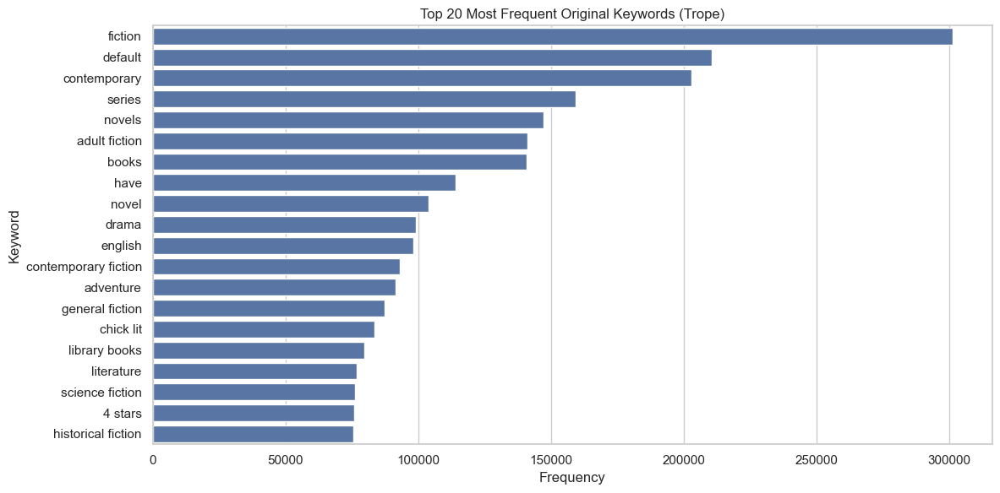


Distribution of Mapped Genres/Tropes (Trope - Top 20):
Empty DataFrame
Columns: [genre_trope, count]
Index: []


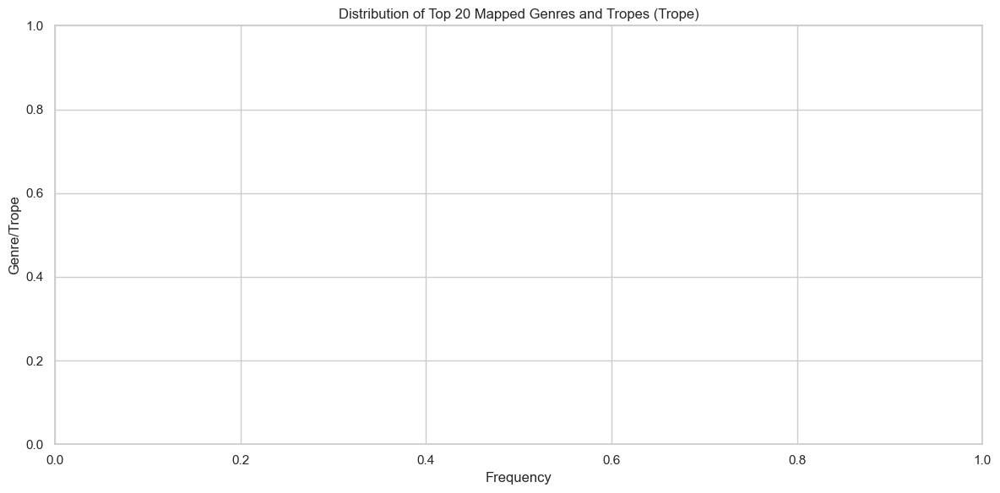


Coverage of your Genre/Trope Mapping (Trope Keywords): 0.00%

Top 20 Unmapped Original Keywords (Trope):
                     keyword   count
452828               fiction  301298
346588               default  210744
190457          contemporary  203025
286137                series  159422
98310                 novels  147129
341714         adult fiction  141095
481723                 books  140664
28057                   have  114100
378261                 novel  103926
70008                  drama   99003
491162               english   98062
564093  contemporary fiction   93027
449172             adventure   91412
553910       general fiction   87406
191372             chick lit   83593
315902         library books   79752
262885            literature   76817
278545       science fiction   76061
528106               4 stars   75884
84898     historical fiction   75649


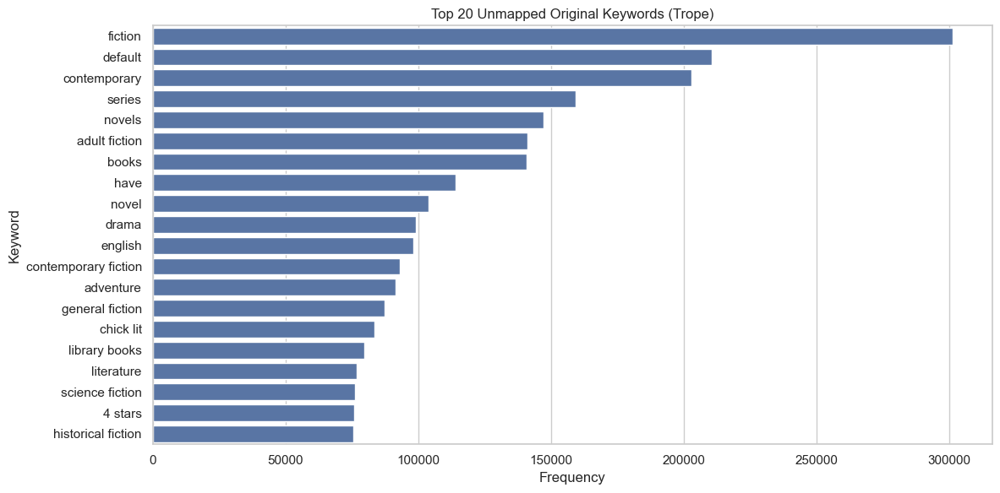


--- Analysis of 'lcgft_genres' ---
Top 20 Most Frequent Original Genres:
                            genre   count
9                 romance fiction  191778
8                 fantasy fiction  143939
10            young adult fiction  138875
0   detective and mystery fiction  125573
1             thrillers (fiction)   91347
11             paranormal fiction   89333
17                science fiction   76964
12             historical fiction   69819
3                humorous fiction   60285
4             creative nonfiction   42213
14              dystopian fiction   34850
5                     biographies   26383
18                vampire fiction   23557
27                    war fiction   22714
21            apocalyptic fiction   20083
22          magic realist fiction   18303
16                  witch fiction   17107
30                  short stories   13438
19               werewolf fiction   13424
28                  ghost stories   12793


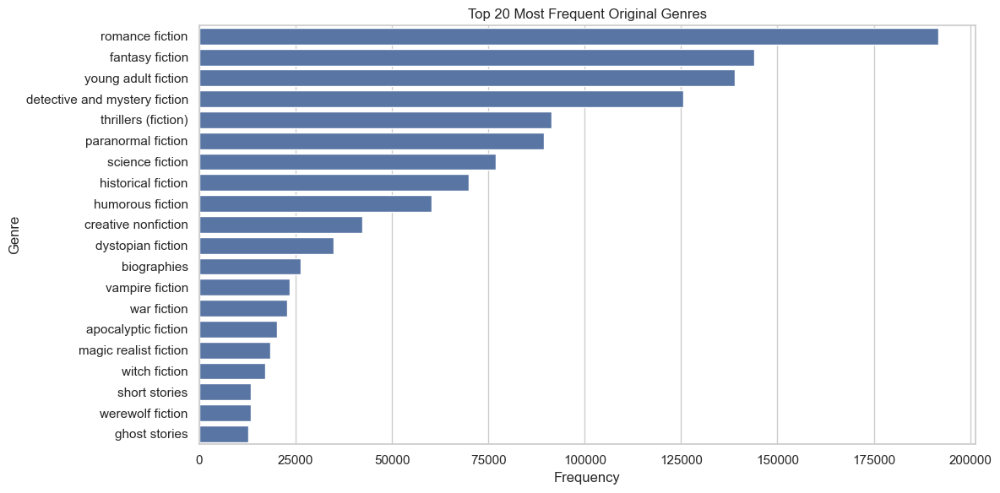


Distribution of Mapped Genres/Tropes (Genre - Top 20):
           genre_trope   count
2  Young adult fiction  138875
1          Biographies   26383
3        Ghost stories   12793
0       Cozy mysteries    5897
4           Tall tales      29
5    Nonfiction novels      15


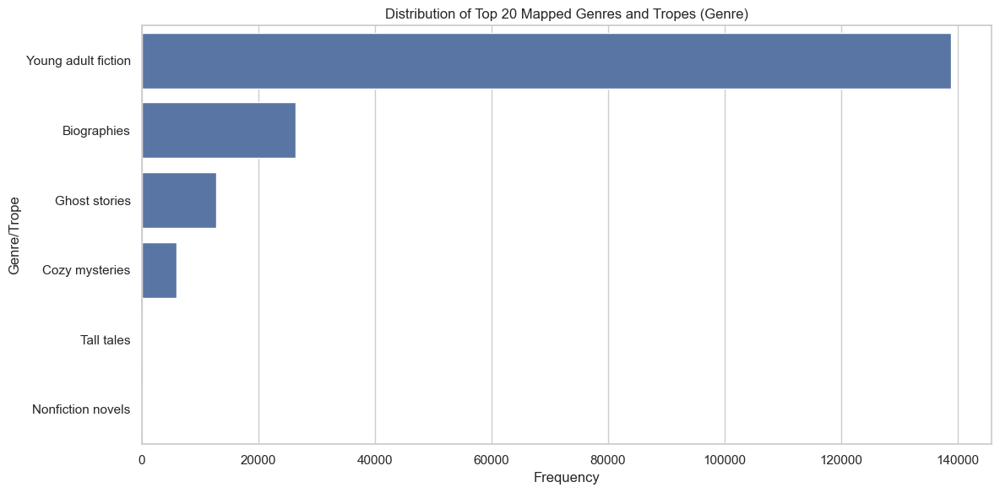


Coverage of your Genre/Trope Mapping (LCGFT Genres): 14.09%

Top 20 Unmapped Original Genres:
                            genre   count
31                romance fiction  191778
1                 fantasy fiction  143939
17  detective and mystery fiction  125573
30            thrillers (fiction)   91347
3              paranormal fiction   89333
13                science fiction   76964
12             historical fiction   69819
27               humorous fiction   60285
20            creative nonfiction   42213
16              dystopian fiction   34850
28                vampire fiction   23557
23                    war fiction   22714
15            apocalyptic fiction   20083
22          magic realist fiction   18303
10                  witch fiction   17107
24                  short stories   13438
11               werewolf fiction   13424
21              satirical fiction    9699
2                     gay fiction    9171
7                   queer fiction    7983


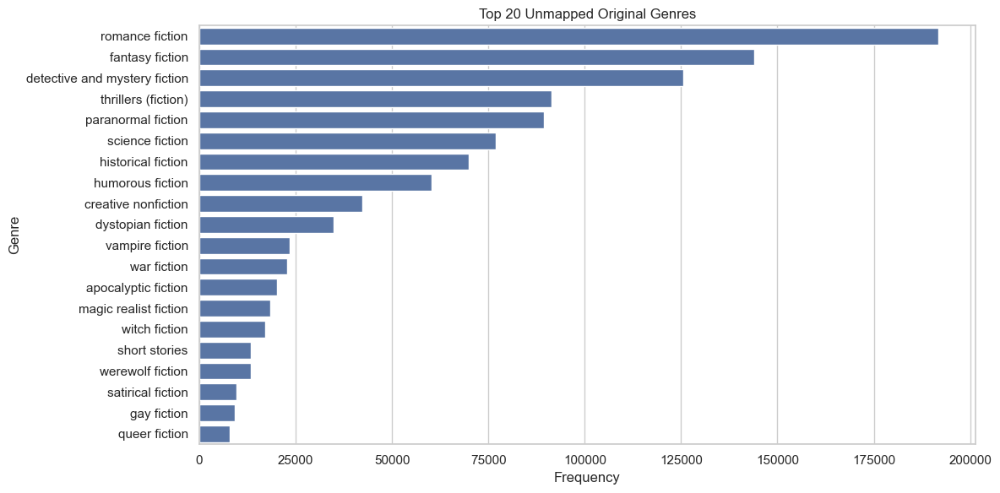

In [87]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
from lcgft_config import lcgft_mapping  # Import the mapping

# Assuming your DataFrame is named 'sample_1star'
data = df_1star

# --- Analysis of 'trope_keywords' ---
original_keywords_column_trope = 'trope_keywords'

def clean_and_split_keywords(keywords_string):
    if isinstance(keywords_string, str):
        return [keyword.strip().lower() for keyword in keywords_string.split(',')]
    elif isinstance(keywords_string, list):
        return [keyword.strip().lower() for keyword in keywords_string]
    return []

data['processed_trope_keywords'] = data[original_keywords_column_trope].apply(clean_and_split_keywords)
all_original_trope_keywords = [keyword for sublist in data['processed_trope_keywords'] for keyword in sublist]

# Frequency Analysis of 'trope_keywords'
trope_keyword_counts = Counter(all_original_trope_keywords)
trope_keyword_counts_df = pd.DataFrame(trope_keyword_counts.items(), columns=['keyword', 'count'])
trope_keyword_counts_df = trope_keyword_counts_df.sort_values(by='count', ascending=False)

print("\n--- Analysis of 'trope_keywords' ---")
print("Top 20 Most Frequent Original Keywords (Trope):")
print(trope_keyword_counts_df.head(20))

plt.figure(figsize=(12, 6))
sns.barplot(x='count', y='keyword', data=trope_keyword_counts_df.head(20))
plt.title('Top 20 Most Frequent Original Keywords (Trope)')
plt.xlabel('Frequency')
plt.ylabel('Keyword')
plt.tight_layout()
plt.show()

# Distribution of Mapped Genres/Tropes for 'trope_keywords'
def map_keywords_to_genres(keywords, genre_map):
    mapped_genres = set()
    for keyword in keywords:
        if keyword in genre_map:
            mapped_genres.add(genre_map[keyword])
    return list(mapped_genres)

data['mapped_genres_tropes_trope'] = data['processed_trope_keywords'].apply(lambda x: map_keywords_to_genres(x, lcgft_mapping))
all_mapped_genres_tropes_trope = [genre for sublist in data['mapped_genres_tropes_trope'] for genre in sublist]
mapped_counts_trope = Counter(all_mapped_genres_tropes_trope)
mapped_counts_df_trope = pd.DataFrame(mapped_counts_trope.items(), columns=['genre_trope', 'count'])
mapped_counts_df_trope = mapped_counts_df_trope.sort_values(by='count', ascending=False)

print("\nDistribution of Mapped Genres/Tropes (Trope - Top 20):")
print(mapped_counts_df_trope.head(20))

plt.figure(figsize=(12, 6))
sns.barplot(x='count', y='genre_trope', data=mapped_counts_df_trope.head(20))
plt.title('Distribution of Top 20 Mapped Genres and Tropes (Trope)')
plt.xlabel('Frequency')
plt.ylabel('Genre/Trope')
plt.tight_layout()
plt.show()

# Coverage of Your Mapping for 'trope_keywords'
mapped_keyword_count_trope = 0
for keywords in data['processed_trope_keywords']:
    for keyword in keywords:
        if keyword in lcgft_mapping:
            mapped_keyword_count_trope += 1

total_original_keyword_count_trope = len(all_original_trope_keywords)
coverage_percentage_trope = (mapped_keyword_count_trope / total_original_keyword_count_trope) * 100

print(f"\nCoverage of your Genre/Trope Mapping (Trope Keywords): {coverage_percentage_trope:.2f}%")

unmapped_keywords_trope = set(all_original_trope_keywords) - set(lcgft_mapping.keys())
print("\nTop 20 Unmapped Original Keywords (Trope):")
unmapped_keyword_counts_trope = Counter({k: trope_keyword_counts[k] for k in unmapped_keywords_trope})
unmapped_counts_df_trope = pd.DataFrame(unmapped_keyword_counts_trope.items(), columns=['keyword', 'count'])
unmapped_counts_df_trope = unmapped_counts_df_trope.sort_values(by='count', ascending=False)
print(unmapped_counts_df_trope.head(20))

plt.figure(figsize=(12, 6))
sns.barplot(x='count', y='keyword', data=unmapped_counts_df_trope.head(20))
plt.title('Top 20 Unmapped Original Keywords (Trope)')
plt.xlabel('Frequency')
plt.ylabel('Keyword')
plt.tight_layout()
plt.show()

# --- Analysis of 'lcgft_genres' ---
original_genres_column = 'lcgft_genres'

data['processed_genres'] = data[original_genres_column].apply(clean_and_split_keywords)
all_original_genres = [genre for sublist in data['processed_genres'] for genre in sublist]

# Frequency Analysis of 'lcgft_genres'
genre_counts = Counter(all_original_genres)
genre_counts_df = pd.DataFrame(genre_counts.items(), columns=['genre', 'count'])
genre_counts_df = genre_counts_df.sort_values(by='count', ascending=False)

print("\n--- Analysis of 'lcgft_genres' ---")
print("Top 20 Most Frequent Original Genres:")
print(genre_counts_df.head(20))

plt.figure(figsize=(12, 6))
sns.barplot(x='count', y='genre', data=genre_counts_df.head(20))
plt.title('Top 20 Most Frequent Original Genres')
plt.xlabel('Frequency')
plt.ylabel('Genre')
plt.tight_layout()
plt.show()

# Distribution of Mapped Genres/Tropes for 'lcgft_genres'
data['mapped_genres_tropes_genre'] = data['processed_genres'].apply(lambda x: map_keywords_to_genres(x, lcgft_mapping))
all_mapped_genres_tropes_genre = [genre_mapped for sublist in data['mapped_genres_tropes_genre'] for genre_mapped in sublist]
mapped_counts_genre = Counter(all_mapped_genres_tropes_genre)
mapped_counts_df_genre = pd.DataFrame(mapped_counts_genre.items(), columns=['genre_trope', 'count'])
mapped_counts_df_genre = mapped_counts_df_genre.sort_values(by='count', ascending=False)

print("\nDistribution of Mapped Genres/Tropes (Genre - Top 20):")
print(mapped_counts_df_genre.head(20))

plt.figure(figsize=(12, 6))
sns.barplot(x='count', y='genre_trope', data=mapped_counts_df_genre.head(20))
plt.title('Distribution of Top 20 Mapped Genres and Tropes (Genre)')
plt.xlabel('Frequency')
plt.ylabel('Genre/Trope')
plt.tight_layout()
plt.show()

# Coverage of Your Mapping for 'lcgft_genres'
mapped_genre_count = 0
for genres in data['processed_genres']:
    for genre in genres:
        if genre in lcgft_mapping:
            mapped_genre_count += 1

total_original_genre_count = len(all_original_genres)
coverage_percentage_genre = (mapped_genre_count / total_original_genre_count) * 100

print(f"\nCoverage of your Genre/Trope Mapping (LCGFT Genres): {coverage_percentage_genre:.2f}%")

unmapped_genres = set(all_original_genres) - set(lcgft_mapping.keys())
print("\nTop 20 Unmapped Original Genres:")
unmapped_genre_counts = Counter({k: genre_counts[k] for k in unmapped_genres})
unmapped_counts_df_genre = pd.DataFrame(unmapped_genre_counts.items(), columns=['genre', 'count'])
unmapped_counts_df_genre = unmapped_counts_df_genre.sort_values(by='count', ascending=False)
print(unmapped_counts_df_genre.head(20))

plt.figure(figsize=(12, 6))
sns.barplot(x='count', y='genre', data=unmapped_counts_df_genre.head(20))
plt.title('Top 20 Unmapped Original Genres')
plt.xlabel('Frequency')
plt.ylabel('Genre')
plt.tight_layout()
plt.show()

In [90]:
import pandas as pd
from collections import Counter
import ast

# Assuming your DataFrame is named 'df_1star'
# Make sure your DataFrame is actually named 'df_1star'
# If it's named 'sample_1star', replace 'df_1star' with 'sample_1star' below

all_genres = []
for genres_str in df_1star['lcgft_genres'].dropna():
    try:
        genres_list = ast.literal_eval(genres_str)
        all_genres.extend([genre.strip().lower() for genre in genres_list])
    except (ValueError, SyntaxError):
        continue

genre_counts = Counter(all_genres)
most_common_genre = genre_counts.most_common(1)

if most_common_genre:
    most_popular_genre = most_common_genre[0][0]
    count = most_common_genre[0][1]
    print(f"The most 'popular' (most frequently occurring in 1-star reviews) genre is: '{most_popular_genre}' with {count} mentions.")
else:
    print("No genres found in the 1-star reviews.")

No genres found in the 1-star reviews.


In [91]:
print(df_1star['lcgft_genres'].isnull().sum())
print((df_1star['lcgft_genres'] == '').sum())

0
0


In [88]:
import pandas as pd
from collections import Counter
import ast

# Assuming your DataFrame is named 'sample_1star'

all_genres = []
for genres_str in df_1star['lcgft_genres'].dropna():
    try:
        genres_list = ast.literal_eval(genres_str)
        all_genres.extend([genre.strip().lower() for genre in genres_list])
    except (ValueError, SyntaxError):
        continue

genre_counts = Counter(all_genres)
most_common_genre = genre_counts.most_common(1)

if most_common_genre:
    most_popular_genre = most_common_genre[0][0]
    count = most_common_genre[0][1]
    print(f"The most 'popular' (most frequently occurring in 1-star reviews) genre is: '{most_popular_genre}' with {count} mentions.")
else:
    print("No genres found in the 1-star reviews.")

No genres found in the 1-star reviews.
